<font face="Times New Roman" size=5>
<div dir=rtl align="center">
<font face="Times New Roman" size=5>
In The Name of God
</font>
<br>
<img src="https://logoyar.com/content/wp-content/uploads/2021/04/sharif-university-logo.png" alt="University Logo" width="150" height="150">
<br>
<font face="Times New Roman" size=4 align=center>
Sharif University of Technology - Department of Electrical Engineering
</font>
<br>
<font color="#008080" size=6>
Deep Generative Models
</font>
<hr/>
<font color="#800080" size=5>
Assignment 1 : Deep Autoregressive Models
<br>
</font>
<font size=5>
Instructor: Dr. S. Amini
<br>
</font>
<font size=4>
Fall 2025
<br>
</font>
<font face="Times New Roman" size=4>
</font>
<hr>
<font color='red'  size=4>
<br>
</font>
<font face="Times New Roman" size=4 align=center>
Feel free to ask your questions in Telegram : @imoonamm
</font>
<br>
<hr>
</div></font>

**You should only change the blank sections, marked with TODO**

Pay attention to docstrings, as they may drastically help with your implementation.

You are advised to read all related papers and material, to help you better understand the design of each model.

# Question 1: WaveNet : A generative model for raw audio

WaveNet is a general purpose technology that has allowed us to unlock a range of new applications, from improving video calls on even the weakest connections to helping people regain their original voice after losing the ability to speak.

![Local GIF](unnamed.gif)

WaveNet models raw audio waveforms autoregressively:
$
p(x_{1:T}) = \prod_{t=1}^T p(x_t \mid x_{<t})
$
\
Instead of predicting spectrograms or using a vocoder, WaveNet predicts the next audio sample directly (often after µ-law companding and 8-bit/256-way quantization). This yields very natural sounding speech and music because the network learns the waveform structure end-to-end.

## 2. Core

### 2.1 Causal convolutions
A causal 1D convolution ensures predictions at time \(t\) don't depend on future samples:
- Achieved by padding only on the left (past).
- In practice, use `padding = dilation * (kernel_size - 1)` and then trim the rightmost elements (or use `Chomp1d` cropping).

### 2.2 Dilated convolutions
Dilations `[1, 2, 4, 8, ...]` in stacked layers let the receptive field grow exponentially with depth while keeping the number of parameters manageable. A stack of several cycles of dilations covers long temporal context (hundreds to thousands of samples).

### 2.3 Gated activation units
Each residual block uses a gated unit:
$
\text{z} = \tanh(W_f * x) \odot \sigma(W_g * x)
$
where `*` is dilated causal conv, `W_f` and `W_g` are convolution filters. The output splits to (1) residual connection and (2) skip connection that is added to final output.

### 2.4 Residual & skip connections
- Residual: `x_{l+1} = x_l + \text{residual\_out}` to ease training.
- Skip: every block outputs a skip tensor; all skip outputs are summed, then passed through post-processing (ReLU, Conv, softmax) to produce the final distribution over quantized samples.

### 2.5 Output quantization / softmax
Audio samples are often µ-law quantized to 256 values; WaveNet predicts a categorical distribution (`softmax(256)`) over those values for each time step. Continuous outputs are also possible (mixture of logistics / Gaussians) but discrete softmax is standard in the original paper.

### 2.6 Conditioning
- **Global conditioning**: a per-utterance vector (e.g., speaker id embedding) is added to layer activations.
- **Local conditioning**: low-rate features (e.g., mel spectrogram) are upsampled (transposed conv / nearest) and added at each time step.

---

## 3. Training & sampling

### Training
- Teacher forcing: at training time the network receives true previous samples and learns to predict the next sample with cross-entropy loss (if quantized).
- Batch size and optimization: use Adam, gradient clipping recommended for stability.
- Preprocess: µ-law companding + 256-level quantization is common.

### Sampling (inference)
- Autoregressive generation: sample one sample at a time and feed it back.
- Slow by default — many acceleration techniques exist (distillation → Parallel Wavenet, caching convolutions, WaveRNN, etc.).



**Reference:** [WaveNet: A Generative Model for Raw Audio* (van den Oord et al., DeepMind, 2016)](https://arxiv.org/abs/1609.03499)


In [ ]:
!pip install torchaudio
# !pip install git+git://github.com/pytorch/audio
import torchaudio
import os

In [ ]:
import numpy as np
from matplotlib import pyplot as plt
import torch
from torch import nn
from torch.nn import ModuleList
from IPython.display import Audio
from torch.autograd import Variable
import torch.nn.functional as F
device = "cuda" if torch.cuda.is_available() else "cpu"
print("Using {} device".format(device))

Using cuda device


### at first you must convert input into One Hot vector

5 Points


In [ ]:
class OneHot(nn.Module):
    def __init__(self, MU):
        super(OneHot,self).__init__()
        self.MU = MU
        self.ones = None

    def forward(self, x):
        x = x.long()
        if self.ones is None or self.ones.size(0) != self.MU or self.ones.device != x.device:
            self.ones = torch.eye(self.MU, device=x.device)
        return self.ones.index_select(0, x.view(-1)).view(*x.size(), self.MU)

    def __repr__(self):
        return self.__class__.__name__ + "({})".format(self.MU)

Before diving into the WaveNet model itself, it’s important to understand what kind of **data** we are modeling — **raw audio waveforms**.  
Neural networks can only process numbers, so we need to represent sound in a numerical form that captures its essential structure and variation.

---

## 1. Sampling Rate and Bit Depth

### Sound as a Signal
Sound in the real world is a **continuous analog waveform** — a pressure signal that varies smoothly over time.  
To process it digitally, we **sample** it: we take discrete measurements of the amplitude at equally spaced time intervals.

This process converts a continuous signal into a **time series of numbers**:
$
x = [x_1, x_2, \dots, x_T]
$
where each \(x_t\) represents the air pressure (or voltage) at time step \(t\).

---

### Sampling Rate
The **sampling rate** defines **how many times per second** we measure the amplitude of the signal.  
Typical values:
- CD quality audio: 44,100 Hz (samples per second)
- Speech datasets: 16,000 Hz or 22,050 Hz

A higher sampling rate means more detail, but also more data to process.  
WaveNet typically models 16 kHz or 22 kHz audio for speech generation tasks.

---

### Bit Depth
Each recorded sample must be represented by a finite number of bits.  
The **bit depth** determines the range and precision of these values:
- 8-bit → 256 possible levels  
- 16-bit → 65,536 levels  
- 24-bit → 16,777,216 levels  

The bit depth affects the **signal-to-noise ratio (SNR)** — higher bit depth means less quantization noise and a larger dynamic range:
$
\text{SNR} \approx 6.02 \times \text{bit depth} + 1.76\ \text{dB}
$

For example:
- 8-bit ≈ 49.9 dB SNR  
- 16-bit ≈ 98 dB SNR

---

## 2. From Audio to Time Series

After digitization, the audio signal becomes a **sequence of numbers over time**, also known as a **time series**.  
Each point depends on previous ones — this temporal dependency is what WaveNet models autoregressively:
$
p(x_{1:T}) = \prod_{t=1}^{T} p(x_t \mid x_{<t})
$

However, raw 16-bit audio contains **too many values** (65,536 possible amplitudes).  
Predicting the exact next value among that huge range is extremely hard for a neural network.

To simplify, we reduce this dynamic range to a smaller set — typically **256 levels** — using a technique called **µ-law companding**.

---

## 3. µ-law Quantization (Companding Transformation)

### Motivation
Human hearing follows the **Weber–Fechner law** — our perception of changes in loudness is **logarithmic**, not linear.  
That means we are more sensitive to small amplitude changes in quiet sounds than in loud ones.

µ-law companding exploits this property by **compressing the amplitude range logarithmically** —  
it allocates more resolution to small signals (quiet sounds) and less to large ones.

---

### µ-law Formula

$
f(x) = \text{sign}(x) \cdot \frac{\ln(1 + \mu |x|)}{\ln(1 + \mu)}, \quad -1 \le x \le 1
$

where:
- \(x\) = input waveform (normalized to [-1, 1])  
- \(\mu\) = companding constant (usually 255 for 8-bit quantization)

After applying µ-law, we map the range \([-1, 1]\) to discrete integer values \([0, 255]\).

---


## Defining Wavenet

20 Points

The following figure describes the overall architecture of WaveNet. Note that Transformers were non-existent in 2016!

![Wavenet Arch](WaveNet.png)

In [ ]:
class Wavenet(nn.Module):
    def __init__(self, dilation_depth, n_blocks, n_dil_channnels,
                 n_residual_channels, n_skip_channels, n_category, kernel_size):
        super(Wavenet, self).__init__()
        self.dilation_depth = dilation_depth
        self.n_blocks = n_blocks
        self.n_dil_channnels = n_dil_channnels
        self.n_residual_channels = n_residual_channels
        self.n_skip_channels = n_skip_channels
        self.n_category = n_category
        self.kernel_size = kernel_size
        self.One_hot = OneHot(n_category)

        ### Building the model ###

        ## creating first channels ##
        self.first_conv = nn.Conv1d(
            self.n_category,
            self.n_residual_channels,
            self.kernel_size,
            padding=0
        )

        ### Creating wavenet blocks stacks ###
        self.filter_convs = ModuleList()
        self.gate_convs = ModuleList()
        self.residual_convs = ModuleList()
        self.skip_convs = ModuleList()
        self.dilations = []

        for _ in range(self.n_blocks):
            for i in range(self.dilation_depth):
                dilation = 2 ** i
                self.dilations.append(dilation)

                self.filter_convs.append(
                    nn.Conv1d(
                        self.n_residual_channels,
                        self.n_dil_channnels,
                        self.kernel_size,
                        padding=0,
                        dilation=dilation
                    )
                )

                self.gate_convs.append(
                    nn.Conv1d(
                        self.n_residual_channels,
                        self.n_dil_channnels,
                        self.kernel_size,
                        padding=0,
                        dilation=dilation
                    )
                )

                self.residual_convs.append(
                    nn.Conv1d(
                        self.n_dil_channnels,
                        self.n_residual_channels,
                        1
                    )
                )

                self.skip_convs.append(
                    nn.Conv1d(
                        self.n_dil_channnels,
                        self.n_skip_channels,
                        1
                    )
                )

        ## post convolutions ##
        self.post_relu1 = nn.ReLU()
        self.post_conv1 = nn.Conv1d(
            self.n_skip_channels,
            self.n_skip_channels,
            1
        )
        self.post_relu2 = nn.ReLU()
        self.post_conv2 = nn.Conv1d(
            self.n_skip_channels,
            self.n_category,
            1
        )

    def forward(self, x):
        if x.dim() == 1:
            x = x.unsqueeze(0)

        x = self.One_hot(x).float()
        x = x.transpose(1, 2)
        x = F.pad(x, (self.kernel_size - 1, 0))
        x = self.first_conv(x)

        skip = 0
        for i, dilation in enumerate(self.dilations):
            residual = x
            pad = dilation * (self.kernel_size - 1)

            x_f = F.pad(residual, (pad, 0))
            x_f = self.filter_convs[i](x_f)

            x_g = F.pad(residual, (pad, 0))
            x_g = self.gate_convs[i](x_g)

            z = torch.tanh(x_f) * torch.sigmoid(x_g)

            s = self.skip_convs[i](z)
            if isinstance(skip, int):
                skip = s
            else:
                skip = skip + s

            r = self.residual_convs[i](z)
            x = residual + r

        x = self.post_relu1(skip)
        x = self.post_conv1(x)
        x = self.post_relu2(x)
        x = self.post_conv2(x)

        x = x.transpose(1, 2)
        return x

    ### Function to generate samples ###
    def generate(self, input, num_samples=100):
        self.eval()

        if input.dim() == 2:
            current = input.squeeze(0).clone()
        else:
            current = input.view(-1).clone()

        gen_list = current.tolist()

        with torch.no_grad():
            for _ in range(num_samples):
                x_in = current.unsqueeze(0)
                logits = self.forward(x_in)
                probs = torch.softmax(logits[0, -1], dim=0)
                sample = torch.multinomial(probs, 1)
                current = torch.cat([current, sample.view(-1)], dim=0)
                gen_list.append(int(sample.item()))

        return gen_list

Quantization of 16 bit audio

5 Points

In [ ]:
def mulaw_quantize(x, qc):
    #TODO
    mu = qc - 1

    if isinstance(x, torch.Tensor):
        x = x.float()
        x = torch.clamp(x, -1.0, 1.0)
        mu_t = torch.tensor(float(mu), dtype=x.dtype, device=x.device)
        y = torch.sign(x) * torch.log1p(mu_t * torch.abs(x)) / torch.log1p(mu_t)
        x_mu = ((y + 1) / 2 * mu_t + 0.5).long()
    else:
        x = x.astype(np.float32)
        x = np.clip(x, -1.0, 1.0)
        y = np.sign(x) * np.log1p(mu * np.abs(x)) / np.log1p(mu)
        x_mu = ((y + 1) / 2 * mu + 0.5).astype(np.int64)

    return x_mu

Inverse quantization

5 Points

In [ ]:
def inv_mulaw_quantize(x_mu, quantization_channels=256, device = device):
    #TODO
    mu = quantization_channels - 1

    if isinstance(x_mu, torch.Tensor):
        x_mu = x_mu.to(device).float()
        mu_t = torch.tensor(float(mu), dtype=x_mu.dtype, device=x_mu.device)
        y = x_mu / mu_t * 2.0 - 1.0
        x = torch.sign(y) * (torch.expm1(torch.log1p(mu_t) * torch.abs(y)) / mu_t)
    else:
        x_mu = x_mu.astype(np.float32)
        mu_f = float(mu)
        y = x_mu / mu_f * 2.0 - 1.0
        x = np.sign(y) * (np.expm1(np.log1p(mu_f) * np.abs(y)) / mu_f)

    return x

## Load Dataset
In this part you must load the audio_dataset.npz that exist in zip file of homework

10 Points

In [ ]:
import os
import os.path
import math
import threading
import torch
import torch.utils.data
import numpy as np
import librosa as lr
import bisect


class WavenetDataset(torch.utils.data.Dataset):
    def __init__(self,
                 dataset_file,
                 item_length,
                 target_length,
                 file_location=None,
                 classes=256,
                 sampling_rate=16000,
                 mono=True,
                 normalize=False,
                 dtype=np.uint8,
                 train=True,
                 test_stride=100):

        #           |----receptive_field----|
        #                                 |--output_length--|
        # example:  | | | | | | | | | | | | | | | | | | | | |
        # target:                           | | | | | | | | | |

        self.dataset_file = dataset_file
        self._item_length = item_length
        self._test_stride = test_stride
        self.target_length = target_length
        self.classes = classes

        if not os.path.isfile(dataset_file):
            assert file_location is not None, "no location for dataset files specified"
            self.mono = mono
            self.normalize = normalize

            self.sampling_rate = sampling_rate
            self.dtype = dtype
            self.create_dataset(file_location, dataset_file)
        else:
            # Unknown parameters of the stored dataset
            # TODO Can these parameters be stored, too?
            self.mono = None
            self.normalize = None

            self.sampling_rate = None
            self.dtype = None

        self.data = np.load(self.dataset_file, mmap_mode='r')
        self.start_samples = [0]
        self._length = 0
        self.calculate_length()
        self.train = train
        print("one hot input")
        # assign every *test_stride*th item to the test set

        all_indices = list(range(self._length))
        self.test_indices = list(range(0, self._length, self._test_stride))
        test_set = set(self.test_indices)
        self.train_indices = [i for i in all_indices if i not in test_set]

    def calculate_length(self):
        start_samples = [0]
        for i in range(len(self.data.keys())):
            start_samples.append(start_samples[-1] + len(self.data['arr_' + str(i)]))
        available_length = start_samples[-1] - (self._item_length - (self.target_length - 1)) - 1
        self._length = math.floor(available_length / self.target_length)
        self.start_samples = start_samples

    def set_item_length(self, l):
        self._item_length = l
        self.calculate_length()

    def _get_sequence(self, start, length):
        seqs = []
        remaining = length
        pos = start
        total_samples = self.start_samples[-1]
        if pos < 0 or pos + length > total_samples:
            raise IndexError("Requested slice is out of bounds")
        while remaining > 0:
            file_index = bisect.bisect_right(self.start_samples, pos) - 1
            if file_index < 0 or file_index >= len(self.start_samples) - 1:
                raise IndexError("File index out of bounds")
            file_start = self.start_samples[file_index]
            offset = pos - file_start
            arr = self.data['arr_' + str(file_index)]
            take = min(remaining, len(arr) - offset)
            seqs.append(arr[offset:offset + take])
            pos += take
            remaining -= take
        if len(seqs) == 1:
            return seqs[0]
        return np.concatenate(seqs, axis=0)

    def __getitem__(self, idx):
        # TODO: Clarify sample_index calculation for train/test with test_stride

        # TODO: Check file_index bounds; currently prints error, consider raising IndexError

        if self.train:
            original_idx = self.train_indices[idx]
        else:
            original_idx = self.test_indices[idx]

        if original_idx < 0 or original_idx >= self._length:
            raise IndexError("Index out of range")

        sample_index = original_idx * self.target_length

        # TODO: Avoid repeated np.load calls; cache self.data in __init__ instead

        total_len = self._item_length
        example = self._get_sequence(sample_index, total_len).astype(np.float32)

        # TODO: Optimize cross-file slicing; currently concatenates arrays which copies memory

        max_abs = np.max(np.abs(example)) + 1e-8
        example = example / max_abs
        example_q = quantize_data(example, self.classes).astype(np.int64)

        target = example_q[-self.target_length:]
        one_hot = example_q

        # TODO: One-hot creation is memory heavy; consider returning integer indices and use nn.Embedding in model

        return one_hot, target


    def __len__(self):
        if self.train:
            return len(self.train_indices)
        else:
            return len(self.test_indices)


def quantize_data(data, classes):
    return mulaw_quantize(data, classes)


def list_all_audio_files(location):
    audio_files = []
    for root, dirs, files in os.walk(location):
        for f in files:
            fl = f.lower()
            if fl.endswith(('.wav', '.flac', '.mp3', '.ogg', '.m4a', '.wma')):
                audio_files.append(os.path.join(root, f))
    audio_files.sort()
    return audio_files


def mu_law_encoding(data, mu):
    data = np.clip(data, -1.0, 1.0)
    mu_x = np.sign(data) * np.log1p(mu * np.abs(data)) / np.log1p(mu)
    return mu_x


def mu_law_expansion(data, mu):
    s = np.sign(data) * (np.expm1(np.abs(data) * np.log1p(mu)) / mu)
    return s

In [ ]:
dilation_depth = 10
n_blocks = 2
n_dilation_channels = 24
n_residual_channels = 24
n_skip_channels = 128
n_category = 256
kernel_size = 2
model = Wavenet(dilation_depth,n_blocks,n_dilation_channels ,n_residual_channels,n_skip_channels,n_category,kernel_size)
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f'The model has {count_parameters(model):,} trainable parameters')
model.to(device)

The model has 184,888 trainable parameters


Wavenet(
  (One_hot): OneHot(256)
  (first_conv): Conv1d(256, 24, kernel_size=(2,), stride=(1,))
  (filter_convs): ModuleList(
    (0): Conv1d(24, 24, kernel_size=(2,), stride=(1,))
    (1): Conv1d(24, 24, kernel_size=(2,), stride=(1,), dilation=(2,))
    (2): Conv1d(24, 24, kernel_size=(2,), stride=(1,), dilation=(4,))
    (3): Conv1d(24, 24, kernel_size=(2,), stride=(1,), dilation=(8,))
    (4): Conv1d(24, 24, kernel_size=(2,), stride=(1,), dilation=(16,))
    (5): Conv1d(24, 24, kernel_size=(2,), stride=(1,), dilation=(32,))
    (6): Conv1d(24, 24, kernel_size=(2,), stride=(1,), dilation=(64,))
    (7): Conv1d(24, 24, kernel_size=(2,), stride=(1,), dilation=(128,))
    (8): Conv1d(24, 24, kernel_size=(2,), stride=(1,), dilation=(256,))
    (9): Conv1d(24, 24, kernel_size=(2,), stride=(1,), dilation=(512,))
    (10): Conv1d(24, 24, kernel_size=(2,), stride=(1,))
    (11): Conv1d(24, 24, kernel_size=(2,), stride=(1,), dilation=(2,))
    (12): Conv1d(24, 24, kernel_size=(2,), stride=(1

### Define data generator

10 Points


In [ ]:
def data_generation(data, fr, seq_len_segment, mu, device=device):
    ###shape of data is [batch_size,seq_len]
    ### we want to randomly choose a starting position and then extract the seq_len_segment
    ### now the data is normalized for mu law encoding
    #TODO
    if isinstance(data, np.ndarray):
        data = torch.from_numpy(data)

    data = data.to(device).float()
    batch_size, total_len = data.size()

    segment_total_len = fr + seq_len_segment
    if total_len < segment_total_len:
        raise ValueError("Sequence length is shorter than fr + seq_len_segment")

    max_start = total_len - segment_total_len
    starts = torch.randint(low=0, high=max_start + 1, size=(batch_size,), device=device)

    segments = []
    for b in range(batch_size):
        s = starts[b].item()
        seg = data[b, s:s + segment_total_len]
        segments.append(seg.unsqueeze(0))

    segments = torch.cat(segments, dim=0)

    quantized = mulaw_quantize(segments, mu)

    x = quantized
    y = quantized[:, -seq_len_segment:]

    return x.to(device), y.to(device)

### Visualize sample of data

5 Points

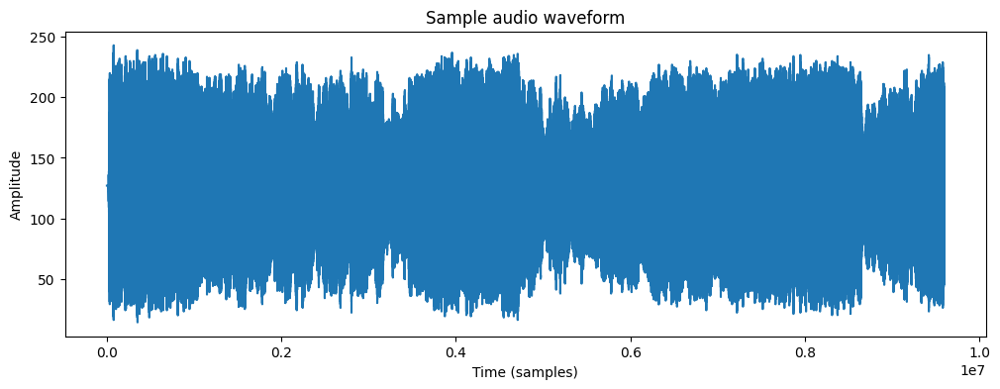

In [ ]:
data_npz = np.load('audio_dataset.npz')
first_key = sorted(data_npz.files)[0]
sample = data_npz[first_key]

plt.figure(figsize=(12, 4))
plt.plot(sample)
plt.title("Sample audio waveform")
plt.xlabel("Time (samples)")
plt.ylabel("Amplitude")
plt.show()

Audio(sample, rate=16000)

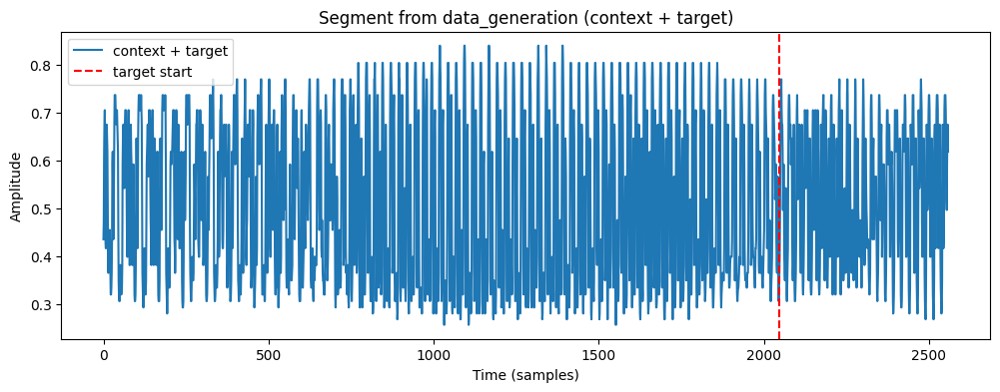

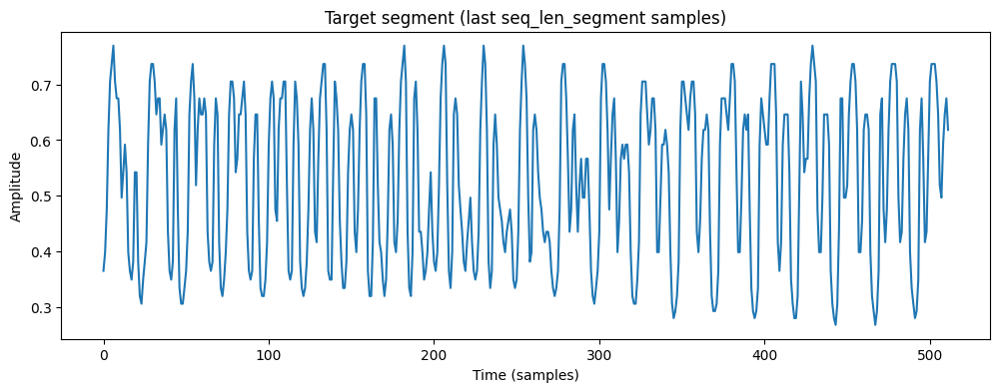

In [ ]:
def compute_receptive_field(kernel_size, dilation_depth, n_blocks):
    dilations = [2 ** i for i in range(dilation_depth)]
    return 1 + (kernel_size - 1) * sum(dilations) * n_blocks

receptive_field = compute_receptive_field(kernel_size, dilation_depth, n_blocks)
target_length = 512
item_length = receptive_field + target_length

data_npz = np.load('audio_dataset.npz')
first_key = sorted(data_npz.files)[0]
raw = data_npz[first_key].astype(np.float32)
raw = raw / (np.max(np.abs(raw)) + 1e-8)

batch = np.expand_dims(raw, axis=0)

fr = receptive_field
seq_len_segment = target_length
mu = n_category

x_q, y_q = data_generation(batch, fr, seq_len_segment, mu, device=device)

x_q = x_q[0]
y_q = y_q[0]

x_wave = inv_mulaw_quantize(x_q, quantization_channels=mu).detach().cpu().numpy()
y_wave = inv_mulaw_quantize(y_q, quantization_channels=mu).detach().cpu().numpy()

plt.figure(figsize=(12, 4))
plt.plot(x_wave, label="context + target")
plt.axvline(len(x_wave) - seq_len_segment, color='r', linestyle='--', label="target start")
plt.title("Segment from data_generation (context + target)")
plt.xlabel("Time (samples)")
plt.ylabel("Amplitude")
plt.legend()
plt.show()

plt.figure(figsize=(12, 4))
plt.plot(y_wave)
plt.title("Target segment (last seq_len_segment samples)")
plt.xlabel("Time (samples)")
plt.ylabel("Amplitude")
plt.show()

### Optimizer and Loss Function

5 Points

In [ ]:
from torch.optim import Adam
#TODO
criterion = nn.CrossEntropyLoss()
optimizer = Adam(model.parameters(), lr=1e-3)

## Training

10 Points

In [ ]:
#TODO
from torch.utils.data import DataLoader
from tqdm.auto import tqdm
import time

def compute_receptive_field(kernel_size, dilation_depth, n_blocks):
    dilations = [2 ** i for i in range(dilation_depth)]
    return 1 + (kernel_size - 1) * sum(dilations) * n_blocks

receptive_field = compute_receptive_field(kernel_size, dilation_depth, n_blocks)
target_length = 512
item_length = receptive_field + target_length

train_dataset = WavenetDataset(
    dataset_file='audio_dataset.npz',
    item_length=item_length,
    target_length=target_length,
    classes=n_category,
    train=True
)

train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True)

num_epochs = 20
train_losses = []
epoch_indices = list(range(1, num_epochs + 1))
best_loss = float("inf")

for epoch in range(1, num_epochs + 1):
    model.train()
    running_loss = 0.0
    epoch_start = time.time()
    num_batches = len(train_loader)
    log_interval = max(1, num_batches // 10)

    batch_bar = tqdm(
        enumerate(train_loader, start=1),
        total=num_batches,
        desc=f"Epoch {epoch}/{num_epochs}",
        leave=True
    )

    for batch_idx, (x, y) in batch_bar:
        x = x.to(device).long()
        y = y.to(device).long()

        optimizer.zero_grad()
        logits = model(x)
        B, L, C = logits.shape
        T = y.size(1)
        logits = logits[:, L - T - 1 : L - 1, :]
        logits = logits.reshape(-1, C)
        y = y.reshape(-1)
        loss = criterion(logits, y)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        avg_loss = running_loss / batch_idx
        lr = optimizer.param_groups[0]["lr"]
        elapsed = time.time() - epoch_start
        time_per_batch = elapsed / batch_idx
        eta_sec = time_per_batch * (num_batches - batch_idx)

        batch_bar.set_postfix(
            b_loss=f"{loss.item():.4f}",
            avg_loss=f"{avg_loss:.4f}",
            lr=f"{lr:.2e}",
            eta=f"{eta_sec/60:.1f}m"
        )

        if batch_idx % log_interval == 0 or batch_idx == num_batches:
            print(
                f"[E{epoch:02d}/{num_epochs:02d} "
                f"B{batch_idx:04d}/{num_batches:04d}] "
                f"batch_loss={loss.item():.4f} "
                f"avg_loss={avg_loss:.4f} "
                f"lr={lr:.2e} "
                f"time={elapsed:.1f}s "
                f"eta_epoch={eta_sec:.1f}s"
            )

    epoch_loss = running_loss / num_batches
    train_losses.append(epoch_loss)
    epoch_time = time.time() - epoch_start
    improved = epoch_loss < best_loss
    if improved:
        best_loss = epoch_loss
    status = "improved" if improved else "no_improve"

    print(
        f"=== Epoch {epoch:02d}/{num_epochs:02d} done "
        f"| loss={epoch_loss:.4f} "
        f"| best={best_loss:.4f} ({status}) "
        f"| time={epoch_time:.1f}s ==="
    )

one hot input


Epoch 1/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E01/20 B1854/18547] batch_loss=1.4175 avg_loss=2.2980 lr=1.00e-03 time=99.1s eta_epoch=892.6s
[E01/20 B3708/18547] batch_loss=1.8055 avg_loss=2.1363 lr=1.00e-03 time=182.0s eta_epoch=728.1s
[E01/20 B5562/18547] batch_loss=1.5084 avg_loss=2.0549 lr=1.00e-03 time=268.4s eta_epoch=626.7s
[E01/20 B7416/18547] batch_loss=1.4395 avg_loss=1.9977 lr=1.00e-03 time=351.4s eta_epoch=527.5s
[E01/20 B9270/18547] batch_loss=2.1197 avg_loss=1.9591 lr=1.00e-03 time=433.1s eta_epoch=433.4s
[E01/20 B11124/18547] batch_loss=1.5092 avg_loss=1.9284 lr=1.00e-03 time=516.3s eta_epoch=344.5s
[E01/20 B12978/18547] batch_loss=1.9407 avg_loss=1.9067 lr=1.00e-03 time=598.0s eta_epoch=256.6s
[E01/20 B14832/18547] batch_loss=1.5788 avg_loss=1.8857 lr=1.00e-03 time=681.0s eta_epoch=170.6s
[E01/20 B16686/18547] batch_loss=1.6492 avg_loss=1.8681 lr=1.00e-03 time=763.8s eta_epoch=85.2s
[E01/20 B18540/18547] batch_loss=2.2862 avg_loss=1.8529 lr=1.00e-03 time=846.3s eta_epoch=0.3s
[E01/20 B18547/18547] batch_loss=2.2084

Epoch 2/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E02/20 B1854/18547] batch_loss=2.0018 avg_loss=1.7007 lr=1.00e-03 time=81.9s eta_epoch=737.5s
[E02/20 B3708/18547] batch_loss=1.8047 avg_loss=1.6952 lr=1.00e-03 time=166.3s eta_epoch=665.5s
[E02/20 B5562/18547] batch_loss=2.0714 avg_loss=1.6936 lr=1.00e-03 time=248.8s eta_epoch=580.8s
[E02/20 B7416/18547] batch_loss=1.6388 avg_loss=1.6853 lr=1.00e-03 time=332.4s eta_epoch=498.9s
[E02/20 B9270/18547] batch_loss=1.6802 avg_loss=1.6814 lr=1.00e-03 time=415.9s eta_epoch=416.3s
[E02/20 B11124/18547] batch_loss=1.4765 avg_loss=1.6772 lr=1.00e-03 time=497.8s eta_epoch=332.2s
[E02/20 B12978/18547] batch_loss=1.2685 avg_loss=1.6756 lr=1.00e-03 time=579.3s eta_epoch=248.6s
[E02/20 B14832/18547] batch_loss=1.2037 avg_loss=1.6725 lr=1.00e-03 time=661.3s eta_epoch=165.6s
[E02/20 B16686/18547] batch_loss=1.8506 avg_loss=1.6682 lr=1.00e-03 time=743.0s eta_epoch=82.9s
[E02/20 B18540/18547] batch_loss=1.9648 avg_loss=1.6637 lr=1.00e-03 time=825.1s eta_epoch=0.3s
[E02/20 B18547/18547] batch_loss=1.4229

Epoch 3/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E03/20 B1854/18547] batch_loss=1.3128 avg_loss=1.6206 lr=1.00e-03 time=82.8s eta_epoch=745.2s
[E03/20 B3708/18547] batch_loss=1.9860 avg_loss=1.6221 lr=1.00e-03 time=165.0s eta_epoch=660.4s
[E03/20 B5562/18547] batch_loss=2.3784 avg_loss=1.6142 lr=1.00e-03 time=245.9s eta_epoch=574.0s
[E03/20 B7416/18547] batch_loss=1.6368 avg_loss=1.6113 lr=1.00e-03 time=326.7s eta_epoch=490.3s
[E03/20 B9270/18547] batch_loss=1.2372 avg_loss=1.6077 lr=1.00e-03 time=408.6s eta_epoch=408.9s
[E03/20 B11124/18547] batch_loss=2.0507 avg_loss=1.6055 lr=1.00e-03 time=489.6s eta_epoch=326.7s
[E03/20 B12978/18547] batch_loss=2.2733 avg_loss=1.6048 lr=1.00e-03 time=571.7s eta_epoch=245.3s
[E03/20 B14832/18547] batch_loss=1.4267 avg_loss=1.6011 lr=1.00e-03 time=659.1s eta_epoch=165.1s
[E03/20 B16686/18547] batch_loss=1.7671 avg_loss=1.5979 lr=1.00e-03 time=742.5s eta_epoch=82.8s
[E03/20 B18540/18547] batch_loss=1.0044 avg_loss=1.5960 lr=1.00e-03 time=826.5s eta_epoch=0.3s
[E03/20 B18547/18547] batch_loss=2.2704

Epoch 4/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E04/20 B1854/18547] batch_loss=2.4478 avg_loss=1.5571 lr=1.00e-03 time=83.6s eta_epoch=753.1s
[E04/20 B3708/18547] batch_loss=2.1312 avg_loss=1.5612 lr=1.00e-03 time=167.6s eta_epoch=670.6s
[E04/20 B5562/18547] batch_loss=1.8169 avg_loss=1.5663 lr=1.00e-03 time=249.6s eta_epoch=582.6s
[E04/20 B7416/18547] batch_loss=1.3826 avg_loss=1.5642 lr=1.00e-03 time=332.0s eta_epoch=498.3s
[E04/20 B9270/18547] batch_loss=1.2479 avg_loss=1.5638 lr=1.00e-03 time=415.4s eta_epoch=415.7s
[E04/20 B11124/18547] batch_loss=0.9930 avg_loss=1.5610 lr=1.00e-03 time=503.1s eta_epoch=335.7s
[E04/20 B12978/18547] batch_loss=1.4362 avg_loss=1.5610 lr=1.00e-03 time=585.0s eta_epoch=251.0s
[E04/20 B14832/18547] batch_loss=1.5062 avg_loss=1.5588 lr=1.00e-03 time=667.7s eta_epoch=167.2s
[E04/20 B16686/18547] batch_loss=1.9395 avg_loss=1.5570 lr=1.00e-03 time=749.4s eta_epoch=83.6s
[E04/20 B18540/18547] batch_loss=1.5563 avg_loss=1.5545 lr=1.00e-03 time=831.4s eta_epoch=0.3s
[E04/20 B18547/18547] batch_loss=1.7395

Epoch 5/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E05/20 B1854/18547] batch_loss=1.0143 avg_loss=1.5330 lr=1.00e-03 time=82.2s eta_epoch=740.3s
[E05/20 B3708/18547] batch_loss=1.0409 avg_loss=1.5352 lr=1.00e-03 time=164.8s eta_epoch=659.6s
[E05/20 B5562/18547] batch_loss=1.2187 avg_loss=1.5312 lr=1.00e-03 time=246.3s eta_epoch=574.9s
[E05/20 B7416/18547] batch_loss=1.2035 avg_loss=1.5319 lr=1.00e-03 time=329.2s eta_epoch=494.1s
[E05/20 B9270/18547] batch_loss=2.0733 avg_loss=1.5317 lr=1.00e-03 time=410.4s eta_epoch=410.7s
[E05/20 B11124/18547] batch_loss=1.3555 avg_loss=1.5310 lr=1.00e-03 time=491.5s eta_epoch=328.0s
[E05/20 B12978/18547] batch_loss=0.9431 avg_loss=1.5292 lr=1.00e-03 time=573.3s eta_epoch=246.0s
[E05/20 B14832/18547] batch_loss=1.6189 avg_loss=1.5263 lr=1.00e-03 time=654.9s eta_epoch=164.0s
[E05/20 B16686/18547] batch_loss=1.4353 avg_loss=1.5275 lr=1.00e-03 time=735.1s eta_epoch=82.0s
[E05/20 B18540/18547] batch_loss=1.1449 avg_loss=1.5268 lr=1.00e-03 time=816.2s eta_epoch=0.3s
[E05/20 B18547/18547] batch_loss=1.4332

Epoch 6/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E06/20 B1854/18547] batch_loss=1.5302 avg_loss=1.5153 lr=1.00e-03 time=81.5s eta_epoch=733.5s
[E06/20 B3708/18547] batch_loss=1.6362 avg_loss=1.5222 lr=1.00e-03 time=168.3s eta_epoch=673.4s
[E06/20 B5562/18547] batch_loss=1.5939 avg_loss=1.5168 lr=1.00e-03 time=250.0s eta_epoch=583.7s
[E06/20 B7416/18547] batch_loss=1.0980 avg_loss=1.5159 lr=1.00e-03 time=331.7s eta_epoch=497.9s
[E06/20 B9270/18547] batch_loss=1.7100 avg_loss=1.5113 lr=1.00e-03 time=416.2s eta_epoch=416.5s
[E06/20 B11124/18547] batch_loss=1.3089 avg_loss=1.5092 lr=1.00e-03 time=497.7s eta_epoch=332.1s
[E06/20 B12978/18547] batch_loss=1.1442 avg_loss=1.5094 lr=1.00e-03 time=578.6s eta_epoch=248.3s
[E06/20 B14832/18547] batch_loss=1.0291 avg_loss=1.5086 lr=1.00e-03 time=659.9s eta_epoch=165.3s
[E06/20 B16686/18547] batch_loss=1.6135 avg_loss=1.5082 lr=1.00e-03 time=741.0s eta_epoch=82.6s
[E06/20 B18540/18547] batch_loss=1.4836 avg_loss=1.5085 lr=1.00e-03 time=822.4s eta_epoch=0.3s
[E06/20 B18547/18547] batch_loss=2.1095

Epoch 7/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E07/20 B1854/18547] batch_loss=1.3122 avg_loss=1.4798 lr=1.00e-03 time=82.8s eta_epoch=745.3s
[E07/20 B3708/18547] batch_loss=1.4199 avg_loss=1.4926 lr=1.00e-03 time=168.3s eta_epoch=673.4s
[E07/20 B5562/18547] batch_loss=0.9711 avg_loss=1.4910 lr=1.00e-03 time=252.1s eta_epoch=588.6s
[E07/20 B7416/18547] batch_loss=1.2400 avg_loss=1.4889 lr=1.00e-03 time=334.4s eta_epoch=502.0s
[E07/20 B9270/18547] batch_loss=0.7659 avg_loss=1.4907 lr=1.00e-03 time=417.3s eta_epoch=417.6s
[E07/20 B11124/18547] batch_loss=2.0826 avg_loss=1.4926 lr=1.00e-03 time=501.4s eta_epoch=334.6s
[E07/20 B12978/18547] batch_loss=1.2863 avg_loss=1.4919 lr=1.00e-03 time=586.6s eta_epoch=251.7s
[E07/20 B14832/18547] batch_loss=1.5256 avg_loss=1.4925 lr=1.00e-03 time=668.4s eta_epoch=167.4s
[E07/20 B16686/18547] batch_loss=1.4830 avg_loss=1.4957 lr=1.00e-03 time=750.3s eta_epoch=83.7s
[E07/20 B18540/18547] batch_loss=1.9509 avg_loss=1.4946 lr=1.00e-03 time=832.1s eta_epoch=0.3s
[E07/20 B18547/18547] batch_loss=1.6698

Epoch 8/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E08/20 B1854/18547] batch_loss=2.0623 avg_loss=1.4773 lr=1.00e-03 time=82.7s eta_epoch=744.9s
[E08/20 B3708/18547] batch_loss=1.2648 avg_loss=1.4792 lr=1.00e-03 time=167.7s eta_epoch=670.9s
[E08/20 B5562/18547] batch_loss=1.4881 avg_loss=1.4795 lr=1.00e-03 time=252.7s eta_epoch=590.0s
[E08/20 B7416/18547] batch_loss=1.3462 avg_loss=1.4820 lr=1.00e-03 time=336.2s eta_epoch=504.6s
[E08/20 B9270/18547] batch_loss=1.5288 avg_loss=1.4821 lr=1.00e-03 time=419.4s eta_epoch=419.7s
[E08/20 B11124/18547] batch_loss=1.9444 avg_loss=1.4814 lr=1.00e-03 time=503.6s eta_epoch=336.0s
[E08/20 B12978/18547] batch_loss=1.6302 avg_loss=1.4832 lr=1.00e-03 time=589.2s eta_epoch=252.8s
[E08/20 B14832/18547] batch_loss=2.2300 avg_loss=1.4839 lr=1.00e-03 time=672.3s eta_epoch=168.4s
[E08/20 B16686/18547] batch_loss=1.1177 avg_loss=1.4836 lr=1.00e-03 time=755.3s eta_epoch=84.2s
[E08/20 B18540/18547] batch_loss=1.1584 avg_loss=1.4828 lr=1.00e-03 time=839.3s eta_epoch=0.3s
[E08/20 B18547/18547] batch_loss=1.2474

Epoch 9/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E09/20 B1854/18547] batch_loss=1.7377 avg_loss=1.4799 lr=1.00e-03 time=84.0s eta_epoch=755.9s
[E09/20 B3708/18547] batch_loss=1.3184 avg_loss=1.4791 lr=1.00e-03 time=170.1s eta_epoch=680.9s
[E09/20 B5562/18547] batch_loss=2.0884 avg_loss=1.4742 lr=1.00e-03 time=253.0s eta_epoch=590.7s
[E09/20 B7416/18547] batch_loss=1.0302 avg_loss=1.4738 lr=1.00e-03 time=335.9s eta_epoch=504.2s
[E09/20 B9270/18547] batch_loss=1.7555 avg_loss=1.4739 lr=1.00e-03 time=418.7s eta_epoch=419.0s
[E09/20 B11124/18547] batch_loss=1.0950 avg_loss=1.4743 lr=1.00e-03 time=499.5s eta_epoch=333.3s
[E09/20 B12978/18547] batch_loss=1.6257 avg_loss=1.4757 lr=1.00e-03 time=580.4s eta_epoch=249.1s
[E09/20 B14832/18547] batch_loss=1.1036 avg_loss=1.4735 lr=1.00e-03 time=662.5s eta_epoch=165.9s
[E09/20 B16686/18547] batch_loss=1.5385 avg_loss=1.4740 lr=1.00e-03 time=745.1s eta_epoch=83.1s
[E09/20 B18540/18547] batch_loss=1.5334 avg_loss=1.4730 lr=1.00e-03 time=832.2s eta_epoch=0.3s
[E09/20 B18547/18547] batch_loss=1.5270

Epoch 10/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E10/20 B1854/18547] batch_loss=1.2710 avg_loss=1.4640 lr=1.00e-03 time=81.6s eta_epoch=734.7s
[E10/20 B3708/18547] batch_loss=1.1612 avg_loss=1.4698 lr=1.00e-03 time=163.5s eta_epoch=654.2s
[E10/20 B5562/18547] batch_loss=1.4905 avg_loss=1.4661 lr=1.00e-03 time=245.2s eta_epoch=572.4s
[E10/20 B7416/18547] batch_loss=2.2884 avg_loss=1.4639 lr=1.00e-03 time=327.3s eta_epoch=491.3s
[E10/20 B9270/18547] batch_loss=1.5978 avg_loss=1.4644 lr=1.00e-03 time=408.6s eta_epoch=408.9s
[E10/20 B11124/18547] batch_loss=1.8464 avg_loss=1.4647 lr=1.00e-03 time=491.9s eta_epoch=328.3s
[E10/20 B12978/18547] batch_loss=1.4587 avg_loss=1.4645 lr=1.00e-03 time=574.2s eta_epoch=246.4s
[E10/20 B14832/18547] batch_loss=1.7015 avg_loss=1.4640 lr=1.00e-03 time=655.9s eta_epoch=164.3s
[E10/20 B16686/18547] batch_loss=0.9067 avg_loss=1.4649 lr=1.00e-03 time=738.4s eta_epoch=82.4s
[E10/20 B18540/18547] batch_loss=0.8844 avg_loss=1.4650 lr=1.00e-03 time=820.2s eta_epoch=0.3s
[E10/20 B18547/18547] batch_loss=1.0768

Epoch 11/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E11/20 B1854/18547] batch_loss=1.4515 avg_loss=1.4566 lr=1.00e-03 time=81.6s eta_epoch=734.5s
[E11/20 B3708/18547] batch_loss=1.3770 avg_loss=1.4532 lr=1.00e-03 time=162.2s eta_epoch=649.1s
[E11/20 B5562/18547] batch_loss=1.0498 avg_loss=1.4534 lr=1.00e-03 time=243.6s eta_epoch=568.7s
[E11/20 B7416/18547] batch_loss=1.9187 avg_loss=1.4553 lr=1.00e-03 time=324.4s eta_epoch=486.9s
[E11/20 B9270/18547] batch_loss=1.0766 avg_loss=1.4549 lr=1.00e-03 time=407.3s eta_epoch=407.7s
[E11/20 B11124/18547] batch_loss=1.6517 avg_loss=1.4575 lr=1.00e-03 time=488.6s eta_epoch=326.1s
[E11/20 B12978/18547] batch_loss=1.6373 avg_loss=1.4580 lr=1.00e-03 time=569.6s eta_epoch=244.4s
[E11/20 B14832/18547] batch_loss=1.0400 avg_loss=1.4586 lr=1.00e-03 time=650.5s eta_epoch=162.9s
[E11/20 B16686/18547] batch_loss=1.4930 avg_loss=1.4580 lr=1.00e-03 time=731.2s eta_epoch=81.6s
[E11/20 B18540/18547] batch_loss=1.4577 avg_loss=1.4577 lr=1.00e-03 time=811.2s eta_epoch=0.3s
[E11/20 B18547/18547] batch_loss=1.7168

Epoch 12/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E12/20 B1854/18547] batch_loss=1.7508 avg_loss=1.4420 lr=1.00e-03 time=80.1s eta_epoch=721.4s
[E12/20 B3708/18547] batch_loss=1.6974 avg_loss=1.4537 lr=1.00e-03 time=159.7s eta_epoch=639.1s
[E12/20 B5562/18547] batch_loss=1.9257 avg_loss=1.4544 lr=1.00e-03 time=240.2s eta_epoch=560.8s
[E12/20 B7416/18547] batch_loss=1.4316 avg_loss=1.4545 lr=1.00e-03 time=319.7s eta_epoch=479.9s
[E12/20 B9270/18547] batch_loss=2.0843 avg_loss=1.4523 lr=1.00e-03 time=400.2s eta_epoch=400.5s
[E12/20 B11124/18547] batch_loss=1.9984 avg_loss=1.4526 lr=1.00e-03 time=480.4s eta_epoch=320.6s
[E12/20 B12978/18547] batch_loss=1.7569 avg_loss=1.4513 lr=1.00e-03 time=560.4s eta_epoch=240.5s
[E12/20 B14832/18547] batch_loss=1.7280 avg_loss=1.4521 lr=1.00e-03 time=641.6s eta_epoch=160.7s
[E12/20 B16686/18547] batch_loss=1.6200 avg_loss=1.4522 lr=1.00e-03 time=721.5s eta_epoch=80.5s
[E12/20 B18540/18547] batch_loss=1.3589 avg_loss=1.4522 lr=1.00e-03 time=801.6s eta_epoch=0.3s
[E12/20 B18547/18547] batch_loss=1.5271

Epoch 13/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E13/20 B1854/18547] batch_loss=1.8563 avg_loss=1.4416 lr=1.00e-03 time=80.2s eta_epoch=721.8s
[E13/20 B3708/18547] batch_loss=1.4142 avg_loss=1.4419 lr=1.00e-03 time=160.4s eta_epoch=641.9s
[E13/20 B5562/18547] batch_loss=1.9287 avg_loss=1.4467 lr=1.00e-03 time=240.9s eta_epoch=562.5s
[E13/20 B7416/18547] batch_loss=1.2300 avg_loss=1.4472 lr=1.00e-03 time=320.7s eta_epoch=481.3s
[E13/20 B9270/18547] batch_loss=1.3150 avg_loss=1.4458 lr=1.00e-03 time=402.6s eta_epoch=402.9s
[E13/20 B11124/18547] batch_loss=1.4222 avg_loss=1.4473 lr=1.00e-03 time=482.0s eta_epoch=321.7s
[E13/20 B12978/18547] batch_loss=1.3333 avg_loss=1.4456 lr=1.00e-03 time=562.6s eta_epoch=241.4s
[E13/20 B14832/18547] batch_loss=1.3963 avg_loss=1.4461 lr=1.00e-03 time=642.0s eta_epoch=160.8s
[E13/20 B16686/18547] batch_loss=2.1834 avg_loss=1.4462 lr=1.00e-03 time=721.3s eta_epoch=80.4s
[E13/20 B18540/18547] batch_loss=1.8728 avg_loss=1.4471 lr=1.00e-03 time=801.1s eta_epoch=0.3s
[E13/20 B18547/18547] batch_loss=1.3866

Epoch 14/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E14/20 B1854/18547] batch_loss=1.3876 avg_loss=1.4308 lr=1.00e-03 time=79.0s eta_epoch=711.1s
[E14/20 B3708/18547] batch_loss=1.6183 avg_loss=1.4394 lr=1.00e-03 time=159.3s eta_epoch=637.5s
[E14/20 B5562/18547] batch_loss=1.4242 avg_loss=1.4399 lr=1.00e-03 time=239.0s eta_epoch=557.9s
[E14/20 B7416/18547] batch_loss=2.0292 avg_loss=1.4406 lr=1.00e-03 time=320.2s eta_epoch=480.6s
[E14/20 B9270/18547] batch_loss=1.3201 avg_loss=1.4393 lr=1.00e-03 time=399.6s eta_epoch=399.9s
[E14/20 B11124/18547] batch_loss=1.6847 avg_loss=1.4403 lr=1.00e-03 time=478.7s eta_epoch=319.4s
[E14/20 B12978/18547] batch_loss=1.0590 avg_loss=1.4401 lr=1.00e-03 time=557.9s eta_epoch=239.4s
[E14/20 B14832/18547] batch_loss=1.9278 avg_loss=1.4414 lr=1.00e-03 time=636.6s eta_epoch=159.4s
[E14/20 B16686/18547] batch_loss=1.6525 avg_loss=1.4432 lr=1.00e-03 time=716.6s eta_epoch=79.9s
[E14/20 B18540/18547] batch_loss=1.1194 avg_loss=1.4420 lr=1.00e-03 time=796.5s eta_epoch=0.3s
[E14/20 B18547/18547] batch_loss=2.0263

Epoch 15/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E15/20 B1854/18547] batch_loss=1.0995 avg_loss=1.4386 lr=1.00e-03 time=79.8s eta_epoch=718.7s
[E15/20 B3708/18547] batch_loss=0.9936 avg_loss=1.4304 lr=1.00e-03 time=160.6s eta_epoch=642.9s
[E15/20 B5562/18547] batch_loss=1.1130 avg_loss=1.4319 lr=1.00e-03 time=240.9s eta_epoch=562.3s
[E15/20 B7416/18547] batch_loss=1.7438 avg_loss=1.4333 lr=1.00e-03 time=321.3s eta_epoch=482.3s
[E15/20 B9270/18547] batch_loss=1.9771 avg_loss=1.4366 lr=1.00e-03 time=401.8s eta_epoch=402.1s
[E15/20 B11124/18547] batch_loss=1.8468 avg_loss=1.4385 lr=1.00e-03 time=482.7s eta_epoch=322.1s
[E15/20 B12978/18547] batch_loss=1.0793 avg_loss=1.4373 lr=1.00e-03 time=563.1s eta_epoch=241.6s
[E15/20 B14832/18547] batch_loss=1.6580 avg_loss=1.4383 lr=1.00e-03 time=645.3s eta_epoch=161.6s
[E15/20 B16686/18547] batch_loss=1.2123 avg_loss=1.4390 lr=1.00e-03 time=725.4s eta_epoch=80.9s
[E15/20 B18540/18547] batch_loss=1.6841 avg_loss=1.4377 lr=1.00e-03 time=806.2s eta_epoch=0.3s
[E15/20 B18547/18547] batch_loss=2.0328

Epoch 16/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E16/20 B1854/18547] batch_loss=1.6742 avg_loss=1.4288 lr=1.00e-03 time=80.3s eta_epoch=722.9s
[E16/20 B3708/18547] batch_loss=1.3410 avg_loss=1.4322 lr=1.00e-03 time=161.0s eta_epoch=644.3s
[E16/20 B5562/18547] batch_loss=1.7789 avg_loss=1.4324 lr=1.00e-03 time=240.9s eta_epoch=562.4s
[E16/20 B7416/18547] batch_loss=1.6272 avg_loss=1.4328 lr=1.00e-03 time=322.7s eta_epoch=484.4s
[E16/20 B9270/18547] batch_loss=1.7698 avg_loss=1.4316 lr=1.00e-03 time=403.2s eta_epoch=403.5s
[E16/20 B11124/18547] batch_loss=1.6026 avg_loss=1.4313 lr=1.00e-03 time=484.2s eta_epoch=323.1s
[E16/20 B12978/18547] batch_loss=1.1736 avg_loss=1.4314 lr=1.00e-03 time=564.8s eta_epoch=242.4s
[E16/20 B14832/18547] batch_loss=2.1585 avg_loss=1.4333 lr=1.00e-03 time=644.7s eta_epoch=161.5s
[E16/20 B16686/18547] batch_loss=0.8667 avg_loss=1.4331 lr=1.00e-03 time=724.8s eta_epoch=80.8s
[E16/20 B18540/18547] batch_loss=1.0343 avg_loss=1.4338 lr=1.00e-03 time=804.6s eta_epoch=0.3s
[E16/20 B18547/18547] batch_loss=1.5880

Epoch 17/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E17/20 B1854/18547] batch_loss=1.5455 avg_loss=1.4216 lr=1.00e-03 time=80.9s eta_epoch=728.3s
[E17/20 B3708/18547] batch_loss=1.5788 avg_loss=1.4207 lr=1.00e-03 time=161.2s eta_epoch=645.3s
[E17/20 B5562/18547] batch_loss=1.7809 avg_loss=1.4225 lr=1.00e-03 time=243.6s eta_epoch=568.7s
[E17/20 B7416/18547] batch_loss=1.3243 avg_loss=1.4274 lr=1.00e-03 time=323.3s eta_epoch=485.2s
[E17/20 B9270/18547] batch_loss=1.2327 avg_loss=1.4287 lr=1.00e-03 time=403.6s eta_epoch=403.9s
[E17/20 B11124/18547] batch_loss=1.0193 avg_loss=1.4289 lr=1.00e-03 time=484.2s eta_epoch=323.1s
[E17/20 B12978/18547] batch_loss=1.2041 avg_loss=1.4286 lr=1.00e-03 time=564.8s eta_epoch=242.4s
[E17/20 B14832/18547] batch_loss=1.2365 avg_loss=1.4305 lr=1.00e-03 time=645.8s eta_epoch=161.8s
[E17/20 B16686/18547] batch_loss=1.8940 avg_loss=1.4313 lr=1.00e-03 time=726.1s eta_epoch=81.0s
[E17/20 B18540/18547] batch_loss=1.2673 avg_loss=1.4307 lr=1.00e-03 time=807.4s eta_epoch=0.3s
[E17/20 B18547/18547] batch_loss=2.1263

Epoch 18/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E18/20 B1854/18547] batch_loss=1.7245 avg_loss=1.4343 lr=1.00e-03 time=80.1s eta_epoch=721.0s
[E18/20 B3708/18547] batch_loss=1.8570 avg_loss=1.4252 lr=1.00e-03 time=161.9s eta_epoch=648.0s
[E18/20 B5562/18547] batch_loss=1.6593 avg_loss=1.4268 lr=1.00e-03 time=242.0s eta_epoch=564.9s
[E18/20 B7416/18547] batch_loss=1.7001 avg_loss=1.4289 lr=1.00e-03 time=323.1s eta_epoch=485.0s
[E18/20 B9270/18547] batch_loss=1.2803 avg_loss=1.4284 lr=1.00e-03 time=403.4s eta_epoch=403.7s
[E18/20 B11124/18547] batch_loss=0.9869 avg_loss=1.4287 lr=1.00e-03 time=483.2s eta_epoch=322.4s
[E18/20 B12978/18547] batch_loss=1.5274 avg_loss=1.4281 lr=1.00e-03 time=563.1s eta_epoch=241.6s
[E18/20 B14832/18547] batch_loss=1.3438 avg_loss=1.4278 lr=1.00e-03 time=643.8s eta_epoch=161.2s
[E18/20 B16686/18547] batch_loss=1.1629 avg_loss=1.4289 lr=1.00e-03 time=723.4s eta_epoch=80.7s
[E18/20 B18540/18547] batch_loss=1.8557 avg_loss=1.4281 lr=1.00e-03 time=803.0s eta_epoch=0.3s
[E18/20 B18547/18547] batch_loss=1.4847

Epoch 19/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E19/20 B1854/18547] batch_loss=1.4254 avg_loss=1.4239 lr=1.00e-03 time=79.8s eta_epoch=718.7s
[E19/20 B3708/18547] batch_loss=0.9231 avg_loss=1.4190 lr=1.00e-03 time=159.1s eta_epoch=636.9s
[E19/20 B5562/18547] batch_loss=1.1358 avg_loss=1.4250 lr=1.00e-03 time=237.9s eta_epoch=555.4s
[E19/20 B7416/18547] batch_loss=1.5275 avg_loss=1.4245 lr=1.00e-03 time=317.6s eta_epoch=476.8s
[E19/20 B9270/18547] batch_loss=1.2230 avg_loss=1.4222 lr=1.00e-03 time=396.7s eta_epoch=397.0s
[E19/20 B11124/18547] batch_loss=1.3585 avg_loss=1.4235 lr=1.00e-03 time=476.0s eta_epoch=317.7s
[E19/20 B12978/18547] batch_loss=1.9280 avg_loss=1.4258 lr=1.00e-03 time=555.6s eta_epoch=238.4s
[E19/20 B14832/18547] batch_loss=1.9080 avg_loss=1.4248 lr=1.00e-03 time=634.6s eta_epoch=159.0s
[E19/20 B16686/18547] batch_loss=1.4319 avg_loss=1.4259 lr=1.00e-03 time=716.3s eta_epoch=79.9s
[E19/20 B18540/18547] batch_loss=1.4708 avg_loss=1.4249 lr=1.00e-03 time=796.0s eta_epoch=0.3s
[E19/20 B18547/18547] batch_loss=0.9611

Epoch 20/20:   0%|          | 0/18547 [00:00<?, ?it/s]

[E20/20 B1854/18547] batch_loss=1.0912 avg_loss=1.4126 lr=1.00e-03 time=80.1s eta_epoch=721.1s
[E20/20 B3708/18547] batch_loss=1.0303 avg_loss=1.4170 lr=1.00e-03 time=160.8s eta_epoch=643.6s
[E20/20 B5562/18547] batch_loss=2.1619 avg_loss=1.4234 lr=1.00e-03 time=241.3s eta_epoch=563.3s
[E20/20 B7416/18547] batch_loss=1.5712 avg_loss=1.4214 lr=1.00e-03 time=320.2s eta_epoch=480.6s
[E20/20 B9270/18547] batch_loss=1.4364 avg_loss=1.4203 lr=1.00e-03 time=399.7s eta_epoch=400.0s
[E20/20 B11124/18547] batch_loss=1.4218 avg_loss=1.4218 lr=1.00e-03 time=479.9s eta_epoch=320.2s
[E20/20 B12978/18547] batch_loss=0.9291 avg_loss=1.4219 lr=1.00e-03 time=559.3s eta_epoch=240.0s
[E20/20 B14832/18547] batch_loss=0.9658 avg_loss=1.4222 lr=1.00e-03 time=639.6s eta_epoch=160.2s
[E20/20 B16686/18547] batch_loss=1.1585 avg_loss=1.4216 lr=1.00e-03 time=718.8s eta_epoch=80.2s
[E20/20 B18540/18547] batch_loss=1.7245 avg_loss=1.4217 lr=1.00e-03 time=798.4s eta_epoch=0.3s
[E20/20 B18547/18547] batch_loss=1.7136

## Plot losses

5 Points

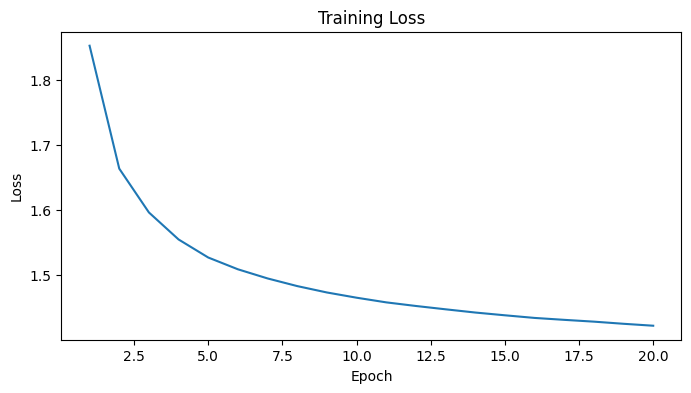

In [ ]:
#TODO
def plot_losses(trainLoss,Epochs):
    plt.figure(figsize=(8,4))
    plt.plot(Epochs, trainLoss)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Loss')
    plt.show()

plot_losses(train_losses, epoch_indices)

## Save the model

5 Points


In [ ]:
#TODO
torch.save(model.state_dict(), 'wavenet_model.pth')

## Generate Audio using trained model

5 Points

one hot input


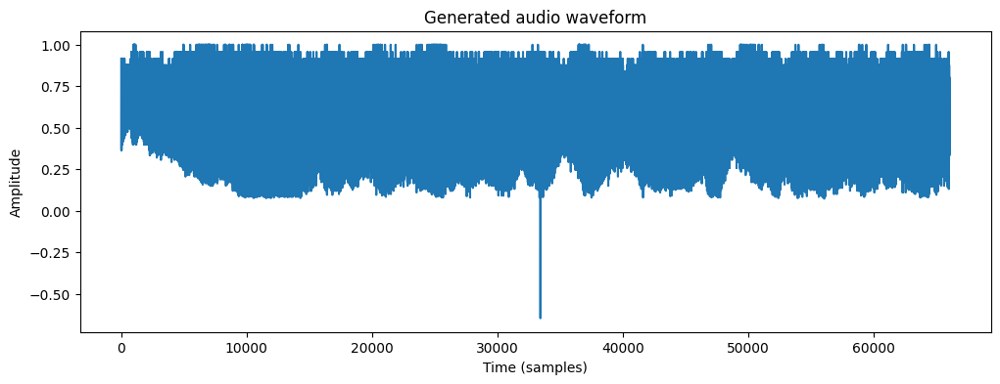

In [ ]:
#TODO
checkpoint_path = "wavenet_model.pth"

model = Wavenet(
    dilation_depth,
    n_blocks,
    n_dilation_channels,
    n_residual_channels,
    n_skip_channels,
    n_category,
    kernel_size
).to(device)

state_dict = torch.load(checkpoint_path, map_location=device)
model.load_state_dict(state_dict)
model.eval()

test_dataset = WavenetDataset(
    dataset_file="audio_dataset.npz",
    item_length=item_length,
    target_length=target_length,
    classes=n_category,
    train=False
)

seed_item_index = 100
seed_indices, _ = test_dataset[seed_item_index]
seed_indices = torch.tensor(seed_indices[:receptive_field], device=device).long().unsqueeze(0)

sample_rate = 16000
duration_seconds = 4
num_samples = sample_rate * duration_seconds

generated_indices = model.generate(seed_indices, num_samples=num_samples)
generated_indices = np.array(generated_indices, dtype=np.int64)

audio_waveform = inv_mulaw_quantize(generated_indices, quantization_channels=n_category)
plt.figure(figsize=(12, 4))
plt.plot(audio_waveform)
plt.title("Generated audio waveform")
plt.xlabel("Time (samples)")
plt.ylabel("Amplitude")
plt.show()

Audio(audio_waveform, rate=sample_rate)

# Question 2: Pixel CNN / Pixel RNN (Optional)

In this question, we explore **deep autoregressive models** for image generation, focusing on PixelCNN and PixelRNN.  

Natural images are high-dimensional and exhibit strong spatial correlations between neighboring pixels. The **PixelRNN** aims to model the **full joint distribution** of pixel intensities, enabling exact likelihood computation and realistic image generation.  

Unlike VAEs or GANs, which rely on latent variables or adversarial training, PixelRNN treats the **image as a sequence of pixels** and directly models:  

$$
p(\mathbf{x}) = \prod_{i=1}^{N} p(x_i \mid x_1, x_2, \ldots, x_{i-1})
$$

Here, each pixel \(x_i\) is conditioned on all previously generated pixels, following a fixed **raster-scan order** (top-left → bottom-right). This transforms image modeling into a **sequence modeling task**, allowing recurrent neural networks (RNNs) to capture long-range spatial dependencies.  

---

### Core Idea

PixelRNN introduces **two-dimensional LSTM architectures** to preserve autoregressive dependencies in images:

- **Row LSTM:** Processes the image row by row (left-to-right), with recurrent connections across both rows and columns.  
- **Diagonal Bi-LSTM:** Processes pixels along diagonals, increasing the receptive field to include all previously generated pixels.  

To maintain causality across color channels, each pixel’s RGB values are generated sequentially (R → G → B).  

![PixelRNN Architecture](image.png)

---

### Architectural Components

1. **Masked Convolutions**  
   Convolutional filters are masked (type A or B) to prevent access to future pixels or channels during training.  

2. **Residual Connections**  
   Stacked recurrent layers use residual links to facilitate gradient flow in deep networks.  

3. **Discrete Softmax Output**  
   Each pixel channel is modeled as a categorical distribution over 256 intensity values, allowing exact log-likelihood computation.  

4. **Loss Function**  
   The training objective is the **negative log-likelihood** of the true pixels under the predicted distributions:

$$
\mathcal{L} = -\sum_i \log p(x_i \mid x_{<i})
$$

---

### Sampling and Generation

Image generation in PixelRNN is **fully autoregressive**:

1. Start at the top-left pixel.  
2. Sequentially sample each pixel from its predicted conditional distribution.  
3. Repeat until the entire image is generated.  

This method produces coherent, high-quality images but is computationally intensive, as each pixel depends on all previously generated pixels.  

---

**Reference:** [PixelRNN Paper (2016)](https://arxiv.org/abs/1601.06759)


## load MNIST

5 Points

In [22]:
import os
import math
from typing import List, Tuple
import numpy as np
from PIL import Image
import torch
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
import torchvision.transforms.functional as F
import torchvision.datasets as datasets

#TODO

IMAGE_SIZE = 28
NUM_CLASSES = 10
NUM_EXAMPLES_PER_EPOCH_FOR_TRAIN = 60000
NUM_EXAMPLES_PER_EPOCH_FOR_EVAL = 10000


class MNISTDataset(Dataset):
    """
    Dataset that reads the MNIST data into memory (list of (label, image)).
    Applies transforms (train/eval) provided in init.
    """
    def __init__(self, data_dir: str, files: List[str], transform=None):
        """
        data_dir: directory containing the MNIST files.
        files: list of filenames (basename) to read from data_dir.
        transform: torchvision transform to apply to PIL image (or custom transform).
        """
        self.data_dir = data_dir
        self.files = files
        self.transform = transform

        # Load all records into memory (60k/10k images is fine)
        use_test = any('test' in fname.lower() for fname in files)
        self.records = datasets.MNIST(root=data_dir, train=not use_test, download=True)

        if len(self.records) == 0:
            raise ValueError("No records loaded from MNIST files.")

    def __len__(self):
        return len(self.records)

    def __getitem__(self, idx):
        img, label = self.records[idx]
        if self.transform:
            img = self.transform(img)
        # After transforms, we expect a torch.FloatTensor image of shape [C, H, W]
        # Return label as long tensor
        return img, torch.tensor(label, dtype=torch.long)


class PerImageStandardization:
    """
    Mimics TensorFlow's per_image_standardization:
      (x - mean) / max(stddev, 1.0/sqrt(N))
    Works on a torch tensor image with shape (C, H, W) and dtype=float32 in range [0,1] or raw values.
    We'll expect inputs are float tensors in range [0,1].
    """
    def __call__(self, tensor: torch.Tensor) -> torch.Tensor:
        # tensor: C x H x W
        if not torch.is_floating_point(tensor):
            tensor = tensor.float()
        mean = tensor.mean()
        std = tensor.std()
        # N = number of pixels * channels
        N = tensor.numel()
        std_min = 1.0 / math.sqrt(N)
        std_adj = max(std.item(), std_min)
        return (tensor - mean) / std_adj


def _train_transform():
    """
    Returns torchvision transform for training (distortions similar to TF code):
    - Random crop to IMAGE_SIZE x IMAGE_SIZE from 28x28 image
    - Random horizontal flip
    - Random brightness and contrast (approximate TF random_brightness/random_contrast)
    - Convert to tensor (0..1)
    - Per-image standardization
    """
    # ColorJitter's brightness and contrast ranges take a factor. TF used:
    # random_brightness with max_delta=63 (on [0,255]) => approx +/- 0.25 in normalized 0..1
    # random_contrast lower=0.2 upper=1.8 => matches contrast jitter factor
    color_jitter = transforms.ColorJitter(brightness=0.25, contrast=(0.2, 1.8))
    return transforms.Compose([
        transforms.RandomCrop(IMAGE_SIZE),
        transforms.RandomHorizontalFlip(),
        color_jitter,
        transforms.ToTensor(),  # gives C x H x W, float in [0,1]
        PerImageStandardization(),
    ])


def _eval_transform():
    """
    Returns transform for evaluation:
     - center crop / pad to IMAGE_SIZE x IMAGE_SIZE (TF used resize_image_with_crop_or_pad which crops center)
     - Convert to tensor and per-image standardize
    """
    # For 28->IMAGE_SIZE center crop:
    return transforms.Compose([
        transforms.CenterCrop(IMAGE_SIZE),
        transforms.ToTensor(),
        PerImageStandardization(),
    ])


def get_train_loader(data_dir: str, batch_size: int, num_workers: int = 16, shuffle: bool = True):
    """
    Returns a DataLoader for training (reads MNIST train data).
    """
    dataset = MNISTDataset(
        data_dir=data_dir,
        files=['train'],
        transform=_train_transform()
    )
    loader = DataLoader(
        dataset,
        batch_size=batch_size,
        shuffle=shuffle,
        num_workers=num_workers,
        pin_memory=True,
    )

    return loader


def get_eval_loader(data_dir: str, batch_size: int, num_workers: int = 8, eval_data: bool = True):
    """
    Returns a DataLoader for evaluation.
    If eval_data==False it reads training data else test data.
    """
    files = ['test'] if eval_data else ['train']
    dataset = MNISTDataset(
        data_dir=data_dir,
        files=files,
        transform=_eval_transform()
    )
    loader = DataLoader(
        dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=num_workers,
        pin_memory=True,
    )

    return loader

## Diagonal LSTM and Masked Convolution

20 Points

In [23]:
import logging
from typing import Optional, Tuple
import math

import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

logging.basicConfig(format="[%(asctime)s] %(message)s", datefmt="%m-%d %H:%M:%S")
logger = logging.getLogger(__name__)

DEFAULT_DATA_FORMAT = "NHWC"

def _is_nchw(x: torch.Tensor) -> bool:
    return x.dim() == 4 and x.shape[1] <= 4 and x.shape[2] > 4  # heuristic; not perfect

def ensure_nhwc(x: torch.Tensor) -> torch.Tensor:
    """Return tensor in NHWC layout (B,H,W,C)."""
    if x.dim() != 4:
        raise ValueError("Expect 4D tensor")
    # If likely NCHW (N,C,H,W) convert to NHWC
    if x.shape[1] <= 4 and x.shape[2] > 4:
        return x.permute(0, 2, 3, 1).contiguous()
    return x

def ensure_nchw(x: torch.Tensor) -> torch.Tensor:
    """Return tensor in NCHW layout (B,C,H,W)."""
    if x.dim() != 4:
        raise ValueError("Expect 4D tensor")
    # If likely NHWC convert to NCHW
    if x.shape[3] <= 4 and x.shape[1] > 4:
        return x.permute(0, 3, 1, 2).contiguous()
    if x.shape[1] <= 4 and x.shape[2] > 4:
        # ambiguous, assume NCHW already
        return x
    # assume NHWC (B,H,W,C)
    if x.shape[3] <= 4:
        return x.permute(0, 3, 1, 2).contiguous()
    return x

def get_shape(inputs: torch.Tensor):
    """Return python list-style shape similar to TF's .as_list()."""
    return list(inputs.size())

# ---------------------------
# skew / unskew (supports NHWC and NCHW; works on NHWC primarily)
# ---------------------------
def skew(inputs: torch.Tensor, scope: str = "skew") -> torch.Tensor:
    """
    The skew function performs a transformation on a 4D tensor,
    either in NHWC format (Batch, Height, Width, Channels) or NCHW format (Batch, Channels, Height, Width).
    The goal of skewing is to shift the data from its original height-wise structure into a diagonal format.
    Specifically, the function combines the height and width dimensions in a way that the resulting tensor has a width of W + H - 1,
    where W is the width of the input tensor and H is the height.
    Accepts NHWC ([B,H,W,C]) or NCHW ([B,C,H,W]) tensors.
    Returns NHWC tensor with new width = W + H - 1
    """
    was_nchw = _is_nchw(inputs)
    if was_nchw:
        x = inputs.permute(0, 2, 3, 1).contiguous()
    else:
        x = inputs

    b, h, w, c = x.shape
    new_w = w + h - 1
    outputs = x.new_zeros((b, h, new_w, c))

    for i in range(h):
        outputs[:, i, i:i + w, :] = x[:, i, :, :]

    logger.debug(f"[skew] {scope} : {inputs.shape} -> {outputs.shape}")

    # if input was NCHW convert outputs back to NCHW style? The code returns NHWC.
    if was_nchw:
        # convert to NCHW before returning to be consistent with conv2d upstream expectations
        return outputs.permute(0, 3, 1, 2).contiguous()  # [B, C, H, new_width]
    return outputs  # NHWC

def unskew(inputs: torch.Tensor, width: Optional[int] = None, scope: str = "unskew") -> torch.Tensor:
    """
    The unskew function performs the reverse of the skew operation.
    It takes a skewed tensor and "un-skews" it back to its original shape.
    If NCHW is provided, it will be converted to NHWC internally and returns NHWC.
    """
    was_nchw = _is_nchw(inputs)
    if was_nchw:
        x = inputs.permute(0, 2, 3, 1).contiguous()
    else:
        x = inputs

    b, h, w_skew, c = x.shape
    if width is None:
        width = w_skew - h + 1

    outputs = x.new_zeros((b, h, width, c))
    for i in range(h):
        outputs[:, i, :, :] = x[:, i, i:i + width, :]

    if was_nchw:
        return outputs.permute(0, 3, 1, 2).contiguous()
    logger.debug(f"[unskew] {scope} : -> {outputs.shape}")
    return outputs

# ---------------------------
# conv2d with optional mask (mask type None/'A'/'B')
# ---------------------------
class MaskedConv2d(nn.Module):
    """
    A conv2d that mimics TF behavior with variable creation and masking.
    The module expects inputs either in NHWC or NCHW; internally we run conv in NCHW.
    weights_shape = [kernel_h, kernel_w, in_channels, out_channels] (TF style).
    """
    def __init__(self,
                 in_channels: int,
                 out_channels: int,
                 kernel_size: Tuple[int, int],
                 mask_type: Optional[str] = None,
                 stride: Tuple[int, int] = (1, 1),
                 padding: str = "SAME",
                 bias: bool = True,
                 weights_initializer=None,
                 name: str = "conv2d"):
        super().__init__()
        self.kernel_h, self.kernel_w = kernel_size
        self.mask_type = mask_type.lower() if mask_type is not None else None
        self.stride = stride
        self.padding = padding
        self.name = name

        # Create weight parameter in PyTorch conv format: [out_channels, in_channels, kh, kw]
        self.weight = nn.Parameter(torch.empty(out_channels, in_channels, self.kernel_h, self.kernel_w))
        if bias:
            self.bias = nn.Parameter(torch.zeros(out_channels))
        else:
            self.register_parameter('bias', None)

        # Initialize weights (Xavier uniform by default)
        nn.init.xavier_uniform_(self.weight)

        # Precompute mask if needed (create in TF ordering then transpose to PyTorch ordering)
        if self.mask_type is not None:
            mask = np.ones((self.kernel_h, self.kernel_w, in_channels, out_channels), dtype=np.float32)
            center_h = self.kernel_h // 2
            center_w = self.kernel_w // 2
            mask[center_h, center_w + 1:, :, :] = 0.
            mask[center_h + 1:, :, :, :] = 0.
            if self.mask_type == 'a':
                mask[center_h, center_w, :, :] = 0.
            # convert mask to shape [out, in, kh, kw] for direct multiplication with self.weight
            mask = mask.transpose(3, 2, 0, 1).copy()
            self.register_buffer('mask', torch.tensor(mask))
        else:
            self.mask = None

    def forward(self, inputs: torch.Tensor):
        # Accept NHWC or NCHW. Convert to NCHW for conv
        x = inputs
        if x.dim() != 4:
            raise ValueError("Expect 4D tensor")
        in_ch = self.weight.shape[1]
        if x.shape[1] == in_ch:
            is_nchw = True
        elif x.shape[-1] == in_ch:
            is_nchw = False
        else:
            is_nchw = _is_nchw(x)

        if is_nchw:
            x = x
        else:
            x = x.permute(0, 3, 1, 2).contiguous()

        weight = self.weight
        if self.mask is not None:
            weight = weight * self.mask

        if isinstance(self.padding, str):
            pad_mode = self.padding.upper()
            if pad_mode == "SAME":
                b, c, h, w = x.shape
                stride_h, stride_w = self.stride
                out_h = math.ceil(float(h) / float(stride_h))
                out_w = math.ceil(float(w) / float(stride_w))
                pad_along_h = max((out_h - 1) * stride_h + self.kernel_h - h, 0)
                pad_along_w = max((out_w - 1) * stride_w + self.kernel_w - w, 0)
                pad_top = pad_along_h // 2
                pad_bottom = pad_along_h - pad_top
                pad_left = pad_along_w // 2
                pad_right = pad_along_w - pad_left
                x = F.pad(x, (pad_left, pad_right, pad_top, pad_bottom))
                padding = 0
            elif pad_mode == "VALID":
                padding = 0
            else:
                padding = 0
        else:
            padding = self.padding

        out = F.conv2d(x, weight, self.bias, stride=self.stride, padding=padding)

        # return in same layout as input
        if not is_nchw:
            out = out.permute(0, 2, 3, 1).contiguous()
        logger.debug(f"[conv2d_{self.mask_type}] {self.name} : {inputs.shape} -> {out.shape}")
        return out

# conv1d implemented via conv2d with kernel_w = 1
class MaskedConv1d(MaskedConv2d):
    def __init__(self, in_channels, out_channels, kernel_size, stride=(1,1), padding="SAME", mask_type=None, bias=True, name="conv1d"):
        # kernel_size is int (height)
        super().__init__(in_channels=in_channels,
                         out_channels=out_channels,
                         kernel_size=(kernel_size, 1),
                         mask_type=mask_type,
                         stride=stride,
                         padding=padding,
                         bias=bias,
                         name=name)

# ---------------------------
# Diagonal LSTM Cell
# ---------------------------
class DiagonalLSTMCell(nn.Module):
    """
    Diagonal LSTM Cell equivalent converted from TF.
    - hidden_dims: number of hidden channels per spatial row
    - height: number of rows
    - channel: input channels (for conv1d s_to_s)
    """
    def __init__(self, hidden_dims: int, height: int, channel: int):
        super().__init__()
        self._hidden_dims = hidden_dims
        self._height = height
        self._channel = channel
        self._num_units = hidden_dims * height
        self._state_size = self._num_units * 2
        self._output_size = self._num_units

        # conv to compute s_to_s (2x1 conv as in TF conv1d)
        # We'll implement as a Conv2d with kernel (2,1) operating on [B, hidden_dims, height, 1]
        # But conv1d in TF used input channels = hidden_dims; output = 4*hidden_dims
        # Use groups=1
        self.s_to_s_conv = MaskedConv1d(in_channels=self._hidden_dims, out_channels=4*self._hidden_dims, kernel_size=2, padding="SAME", name='s_to_s')

    def forward(self, i_to_s: torch.Tensor, state: torch.Tensor) -> Tuple[torch.Tensor, torch.Tensor]:
        """
        i_to_s: [B, 4 * height * hidden_dims]
        state: [B, 2 * num_units] where num_units = height * hidden_dims
        returns: h (B, height*hidden_dims), new_state (B, 2*num_units)
        """
        batch_size = i_to_s.size(0)

        num_units = self._num_units
        height = self._height
        hidden_dims = self._hidden_dims

        c_prev = state[:, :num_units].view(batch_size, height, hidden_dims)
        h_prev = state[:, num_units:].view(batch_size, height, hidden_dims)

        x_i = i_to_s.view(batch_size, height, 4 * hidden_dims)

        h_prev_nhwc = h_prev.unsqueeze(2)
        s_to_s = self.s_to_s_conv(h_prev_nhwc).squeeze(2)

        lstm_inp = x_i + s_to_s

        i, f, o, g = torch.chunk(lstm_inp, 4, dim=2)
        i = torch.sigmoid(i)
        f = torch.sigmoid(f)
        o = torch.sigmoid(o)
        g = torch.tanh(g)

        c = f * c_prev + i * g
        h = o * torch.tanh(c)

        h_flat = h.view(batch_size, num_units)
        c_flat = c.view(batch_size, num_units)
        new_state = torch.cat([c_flat, h_flat], dim=1)

        return h_flat, new_state

# ---------------------------
# diagonal_lstm (sequence loop)
# ---------------------------
def diagonal_lstm(inputs: torch.Tensor, conf, scope: str = 'diagonal_lstm') -> torch.Tensor:
    """
    inputs: NHWC or NCHW. The function follows TF flow:
      - skew inputs -> conv2d 1x1 to produce input_to_state (skewed), transpose to [B, W, H, 4*hidden_dims]
      - reshape to rnn_inputs [B, W, H*4*hidden_dims] and iterate over width dimension
    conf must provide: hidden_dims (int), use_dynamic_rnn (bool optional)
    Returns: outputs in NHWC shape [B, H, W, hidden_dims]
    """
    was_nchw = _is_nchw(inputs)
    x = ensure_nhwc(inputs)
    device = x.device

    b, h, w, c = x.shape

    hidden_dims = getattr(conf, "hidden_dims", None)
    if hidden_dims is None and isinstance(conf, dict):
        hidden_dims = conf["hidden_dims"]
    if hidden_dims is None:
        raise ValueError("conf must provide hidden_dims")

    x_skew = skew(x, scope=scope + "_skew")
    b, h_skew, w_skew, c_skew = x_skew.shape

    i2s_conv = MaskedConv2d(in_channels=c_skew,
                            out_channels=4 * hidden_dims,
                            kernel_size=(1, 1),
                            mask_type=None,
                            padding="SAME",
                            name=scope + "_i2s").to(device)
    input_to_state = i2s_conv(x_skew)

    input_to_state = input_to_state.permute(0, 2, 1, 3).contiguous()
    b2, w2, h2, c2 = input_to_state.shape
    assert h2 == h_skew

    rnn_inputs = input_to_state.view(b2, w2, h2 * c2)

    cell = DiagonalLSTMCell(hidden_dims=hidden_dims, height=h_skew, channel=hidden_dims).to(device)  # <--- ADD .to(device)
    num_units = cell._num_units
    state = input_to_state.new_zeros((b2, 2 * num_units))

    outputs_seq = []
    for t in range(w2):
        h_t, state = cell(rnn_inputs[:, t, :], state)
        outputs_seq.append(h_t)

    outputs_seq = torch.stack(outputs_seq, dim=1)
    outputs_seq = outputs_seq.view(b2, w2, h_skew, hidden_dims)
    outputs_seq = outputs_seq.permute(0, 2, 1, 3).contiguous()

    outputs = unskew(outputs_seq, width=w, scope=scope + "_unskew")

    if was_nchw:
        # convert back to NCHW to be consistent with upstream expectations
        return outputs.permute(0, 3, 1, 2).contiguous()
    return outputs

# ---------------------------
# diagonal_bilstm
# ---------------------------
def diagonal_bilstm(inputs: torch.Tensor, conf, scope: str = 'diagonal_bilstm') -> torch.Tensor:
    """
    Compose forward diagonal_lstm and backward diagonal_lstm then sum appropriately (as TF).
    If conf.use_residual is True, apply 1x1 conv residuals and add to inputs.
    Returns: sum of forward and backward outputs with backward last column zeroed and shifted similar to TF.
    """
    # inputs is NCHW [B,C,H,W]; convert to NHWC [B,H,W,C]
    x = inputs.permute(0, 2, 3, 1).contiguous()

    out_fw = diagonal_lstm(x, conf, scope=scope + "_fw")

    x_rev = torch.flip(x, dims=[2])
    out_bw_tmp = diagonal_lstm(x_rev, conf, scope=scope + "_bw")
    out_bw_tmp = torch.flip(out_bw_tmp, dims=[2])

    b, h, w, c = out_bw_tmp.shape
    out_bw = out_bw_tmp.new_zeros((b, h, w, c))
    out_bw[:, :, 1:, :] = out_bw_tmp[:, :, :-1, :]

    out = out_fw + out_bw

    use_residual = getattr(conf, "use_residual", False)
    if not use_residual and isinstance(conf, dict):
        use_residual = conf.get("use_residual", False)

    if use_residual:
        in_channels = x.shape[-1]
        res_conv = MaskedConv2d(in_channels=in_channels,
                                out_channels=out.shape[-1],
                                kernel_size=(1, 1),
                                mask_type=None,
                                padding="SAME",
                                name=scope + "_res").to(x.device)
        residual = res_conv(x)
        out = out + residual

    # back to NCHW [B,C,H,W]
    return out.permute(0, 3, 1, 2).contiguous()

In [24]:
import os
import glob
import logging
from typing import Optional, Dict, Any, Iterable

import torch
from torch import nn
from torch.utils.tensorboard import SummaryWriter

logger = logging.getLogger(__name__)
logging.basicConfig(format="[%(asctime)s] %(message)s", datefmt="%m-%d %H:%M:%S")


class Statistic:
    """
    the Statistic helper.

    Args:
        model: torch.nn.Module to save/load state_dict from.
        optimizer: optional torch.optim.Optimizer to save/load state.
        data_tag: str label used in TensorBoard scalar names .
        model_dir: directory where checkpoints and logs will be written.
        test_step: not used internally here but kept for API similarity (you can use it externally).
        max_to_keep: how many checkpoints to keep; older are deleted.
        device: device to load tensors to when loading checkpoints (default: cpu).
    """
    def __init__(
        self,
        model: nn.Module,
        optimizer: Optional[torch.optim.Optimizer],
        data_tag: str,
        model_dir: str,
        test_step: int,
        max_to_keep: int = 20,
        device: Optional[torch.device] = None,
    ):
        self.model = model
        self.optimizer = optimizer
        self.data_tag = data_tag
        self.model_dir = model_dir
        self.test_step = test_step
        self.max_to_keep = max_to_keep
        self.device = device if device is not None else torch.device("cpu")

        # internal counter t
        self.t = 0

        # tensorboard writer
        log_dir = os.path.join("logs", self.model_dir)
        os.makedirs(log_dir, exist_ok=True)
        self.writer = SummaryWriter(log_dir=log_dir)

        # Ensure model_dir exists for checkpoints
        os.makedirs(self.model_dir, exist_ok=True)

        # Optionally keep a list of saved checkpoints on disk (sorted)
        self._refresh_checkpoint_list()

        # call reset to initialize whatever you want (kept for API parity)
        self.reset()

        logger.info("Statistic initialized. logs -> %s, checkpoints -> %s", log_dir, self.model_dir)

    def reset(self):
        """
        Override or extend if you need to accumulate running statistics.
        """
        # user can extend this method if they want to keep rolling averages, etc.
        pass

    def _refresh_checkpoint_list(self):
        """
        Internal helper: update the cached list of checkpoint paths sorted by step (ascending).
        """
        pattern = os.path.join(self.model_dir, "checkpoint_*.pt")
        ckpts = glob.glob(pattern)
        # parse t from filename checkpoint_{t}.pt
        def _t_from_name(p):
            try:
                base = os.path.basename(p)
                t_str = base.replace("checkpoint_", "").replace(".pt", "")
                return int(t_str)
            except Exception:
                return -1
        ckpts_sorted = sorted(ckpts, key=_t_from_name)
        self._checkpoints = ckpts_sorted

    def _prune_checkpoints(self):
        """
        Keep only the last `max_to_keep` checkpoints, remove older ones.
        """
        self._refresh_checkpoint_list()
        if self.max_to_keep is None:
            return
        while len(self._checkpoints) > self.max_to_keep:
            old = self._checkpoints.pop(0)
            try:
                os.remove(old)
                logger.info("Removed old checkpoint: %s", old)
            except OSError:
                logger.warning("Failed to remove old checkpoint: %s", old)

    def on_step(self, train_l: float, test_l: float):
        """
        Called at end of a step (or epoch) to increment counter, write summaries, save checkpoints and reset accumulators.
        """
        # increment counter first
        self.t += 1

        # write summaries
        self.inject_summary({'train_l': train_l, 'test_l': test_l}, self.t)

        # save model
        self.save_model(self.t)

        # reset accumulators if any
        self.reset()

    def get_t(self) -> int:
        """Return current step counter."""
        return int(self.t)

    def inject_summary(self, tag_dict: Dict[str, float], t: Optional[int] = None):
        """
        Write scalar summaries to TensorBoard.
        tag_dict: mapping of tag->value, e.g. {'train_l': 0.5}
        t: step (if None uses current internal t)
        """
        step = self.t if t is None else int(t)
        for tag, value in tag_dict.items():
            full_tag = f"{self.data_tag}/{tag}"
            # ensure value is a python float
            try:
                val = float(value)
            except Exception:
                val = float(value.item()) if hasattr(value, "item") else float(value)
            self.writer.add_scalar(full_tag, val, step)
        # flush may be helpful to make summary available quickly
        self.writer.flush()

    def save_model(self, t: Optional[int] = None, extra_state: Optional[Dict[str, Any]] = None):
        """
        Save checkpoint for model (+ optimizer if supplied) and the internal counter 't'.
        extra_state: optional mapping of additional items to store (e.g., scheduler state).
        """
        step = self.t if t is None else int(t)
        ckpt_name = os.path.join(self.model_dir, f"checkpoint_{step}.pt")
        state = {
            't': step,
            'model_state': self.model.state_dict()
        }
        if self.optimizer is not None:
            state['optimizer_state'] = self.optimizer.state_dict()
        if extra_state:
            state['extra'] = extra_state

        # save atomically
        tmp_name = ckpt_name + ".tmp"
        torch.save(state, tmp_name)
        os.replace(tmp_name, ckpt_name)
        logger.info("Saved checkpoint: %s", ckpt_name)

        # refresh and prune
        self._refresh_checkpoint_list()
        self._prune_checkpoints()

    def load_model(self, checkpoint_path: Optional[str] = None, map_location: Optional[torch.device] = None) -> bool:
        """
        Load the latest checkpoint (if checkpoint_path is None) or load the provided checkpoint file.
        Returns True if load succeeded, False otherwise.
        map_location: device to map the checkpoint tensors onto (default: self.device)
        """

        map_location = map_location or self.device

        if checkpoint_path is None:
            # find latest checkpoint
            self._refresh_checkpoint_list()
            if not self._checkpoints:
                logger.info("No checkpoints found in %s", self.model_dir)
                return False
            checkpoint_path = self._checkpoints[-1]

        if not os.path.exists(checkpoint_path):
            logger.warning("Checkpoint path does not exist: %s", checkpoint_path)
            return False

        logger.info("Loading checkpoint: %s", checkpoint_path)
        ckpt = torch.load(checkpoint_path, map_location=map_location)

        # load model state
        if 'model_state' in ckpt:
            try:
                self.model.load_state_dict(ckpt['model_state'])
            except Exception as e:
                logger.exception("Failed to load model_state: %s", e)
                return False
        else:
            logger.warning("Checkpoint missing 'model_state' key")

        # load optimizer state if present and optimizer available
        if 'optimizer_state' in ckpt and self.optimizer is not None:
            try:
                self.optimizer.load_state_dict(ckpt['optimizer_state'])
            except Exception as e:
                logger.exception("Failed to load optimizer_state: %s", e)
                # continue, not fatal

        # restore t if present
        if 't' in ckpt:
            self.t = int(ckpt['t'])
        else:
            # try to infer from filename
            base = os.path.basename(checkpoint_path)
            try:
                self.t = int(base.replace("checkpoint_", "").replace(".pt", ""))
            except Exception:
                self.t = 0

        logger.info("Load SUCCESS: %s (t=%d)", checkpoint_path, int(self.t))
        return True


    def close(self):
        """Close writer etc."""
        try:
            self.writer.close()
        except Exception:
            pass

In [25]:
import logging
logging.basicConfig(format="[%(asctime)s] %(message)s", datefmt="%m-%d %H:%M:%S")

import os
import sys
import pprint
import tarfile
import hashlib
import datetime
import numpy as np

from types import SimpleNamespace
from typing import Any, Dict, Iterable, Optional

# Python3 urllib
import urllib.request

from PIL import Image

pp = pprint.PrettyPrinter().pprint
logger = logging.getLogger(__name__)

# -------------------------
# Small helpers
# -------------------------
def mprint(matrix: Iterable[Iterable[float]], pivot: float = 0.5):
    """Pretty-print a binary-style matrix using '#' and ' ' like the original."""
    for array in matrix:
        print("".join("#" if i > pivot else " " for i in array))


def get_timestamp() -> str:
    """Return a filesystem-friendly timestamp string with local timezone info."""
    now = datetime.datetime.now().astimezone()
    return now.strftime('%Y_%m_%d_%H_%M_%S')


def binarize(images):
    """
    Binarize image(s) by sampling from Uniform(0,1) < pixel_value.
    Accepts a NumPy array or a PyTorch tensor. Returns same type as input (numpy or torch.FloatTensor).
    """
    try:
        import torch
        is_torch = torch.is_tensor(images)
    except Exception:
        is_torch = False

    if is_torch:
        # produce a tensor of same shape & device
        rand = torch.rand_like(images)
        return (rand < images).float()
    else:
        # assume numpy
        return (np.random.uniform(size=images.shape) < images).astype('float32')


# -------------------------
# Image saving
# -------------------------
def save_images(images, height: int, width: int, n_row: int, n_col: int,
                cmin: float = 0.0, cmax: float = 1.0, directory: str = "./", prefix: str = "sample"):
    """
    Save a grid of images to a single image file.
    - images: numpy array of shape (n_row*n_col, H, W) or (n_row*n_col, H, W, C)
              OR shaped (n_row, n_col, H, W) etc. This function will attempt to reshape sensibly.
    - height, width: single image H,W
    - n_row, n_col: grid layout
    """
    # convert torch -> numpy if needed
    try:
        import torch
        if torch.is_tensor(images):
            images = images.detach().cpu().numpy()
    except Exception:
        pass

    imgs = np.asarray(images)
    # handle shapes:
    # If flat list of images: (N, H, W) or (N, H, W, C)
    if imgs.ndim == 3:
        # grayscale stack
        N, H, W = imgs.shape
        C = 1
        imgs = imgs.reshape((N, H, W))
        imgs = imgs.reshape((n_row, n_col, H, W))
        imgs = imgs.transpose(1, 2, 0, 3).reshape((H * n_row, W * n_col))
        mode = 'L'
    elif imgs.ndim == 4:
        N, H, W, C = imgs.shape
        if C == 1:
            imgs = imgs.reshape((n_row, n_col, H, W))
            imgs = imgs.transpose(1, 2, 0, 3).reshape((H * n_row, W * n_col))
            mode = 'L'
        elif C == 3:
            # arrange into grid with channels last
            imgs = imgs.reshape((n_row, n_col, H, W, C))
            imgs = imgs.transpose(1, 2, 0, 3, 4).reshape((H * n_row, W * n_col, C))
            mode = 'RGB'
        else:
            # unsupported channel count: collapse or take first channel
            imgs = imgs[..., 0]
            imgs = imgs.reshape((n_row, n_col, H, W))
            imgs = imgs.transpose(1, 2, 0, 3).reshape((H * n_row, W * n_col))
            mode = 'L'
    else:
        raise ValueError("Unsupported image array shape: %s" % (imgs.shape,))

    # scale pixels from [cmin,cmax] to [0,255]
    if mode == 'L':
        norm = (imgs - cmin) / max((cmax - cmin), 1e-8)
        arr = np.clip(norm * 255.0, 0, 255).astype(np.uint8)
        pil_img = Image.fromarray(arr, mode='L')
    else:
        norm = (imgs - cmin) / max((cmax - cmin), 1e-8)
        arr = np.clip(norm * 255.0, 0, 255).astype(np.uint8)
        pil_img = Image.fromarray(arr, mode='RGB')

    filename = f'{prefix}_{get_timestamp()}.jpg'
    out_path = os.path.join(directory, filename)
    os.makedirs(directory, exist_ok=True)
    pil_img.save(out_path)
    logger.info("Saved image grid to %s", out_path)


# -------------------------
# Model / config helpers
# -------------------------
def get_model_dir(config, exceptions=None):
    """
    Robust replacement for TF-specific get_model_dir:
      - Accepts TF flags object (which stores flags under __flags) or argparse/Namespace/SimpleNamespace.
      - Builds a readable model dir name from config key/value pairs excluding `exceptions`.
      - If the generated name is too long, falls back to an md5 hash to keep path sane.
    """
    exceptions = set(exceptions or [])
    # Try TF-style flags first
    try:
        if hasattr(config, '__dict__') and '__flags' in config.__dict__:
            attrs = dict(config.__dict__['__flags'])
        else:
            # argparse.Namespace / SimpleNamespace / plain object
            attrs = dict(vars(config))
    except Exception:
        # as a last resort, try to use __dict__
        try:
            attrs = dict(config.__dict__)
        except Exception:
            attrs = {}

    # Filter out exceptions and None/empty values that are not informative
    items = []
    for k in sorted(attrs.keys()):
        if k in exceptions:
            continue
        if k.startswith('_'):
            continue
        v = attrs[k]
        if callable(v):
            vstr = v.__name__
        else:
            try:
                vstr = str(v)
            except Exception:
                vstr = repr(v)
        # shorten long values
        if len(vstr) > 40:
            vstr = hashlib.md5(vstr.encode('utf-8')).hexdigest()[:8]
        items.append(f"{k}={vstr}")

    if not items:
        name = "default"
    else:
        name = "_".join(items)

    # sanitize name (remove spaces, slashes)
    name = name.replace(" ", "").replace("/", "_").replace("\\", "_")

    # If too long, shorten using md5
    if len(name) > 180:
        name = hashlib.md5(name.encode("utf-8")).hexdigest()

    return os.path.join('checkpoints', name) + '/'


def preprocess_conf(conf):
    """
    Placeholder to keep API parity with your previous code.
    If you need to normalize or canonicalize flags/options, do it here.
    """
    # For argparse/Namespace we don't need to do anything by default.
    return conf


def check_and_create_dir(directory: str):
    """Create dir if not exists (logs)"""
    if not os.path.exists(directory):
        logger.info('Creating directory: %s' % directory)
        os.makedirs(directory)
    else:
        logger.info('Skip creating directory: %s' % directory)


def show_all_variables(model: Optional[Any] = None):
    """
    Print all trainable variables.
    If `model` is provided (torch.nn.Module), iterate its parameters.
    """
    try:
        import torch
        if model is None:
            logger.warning("No model passed to show_all_variables(model). Nothing to show.")
            return
        total_count = 0
        for idx, (name, param) in enumerate(model.named_parameters()):
            shape = tuple(param.shape)
            count = int(np.prod(shape))
            print("[%2d] %s %s = %s" % (idx, name, shape, count))
            total_count += count
        print("[Total] variable size: %s" % "{:,}".format(total_count))
    except Exception as e:
        logger.exception("show_all_variables failed: %s", e)

## Network
in this part we will impelement a neural network that can be configured to perform pixel-wise predictions, specifically for image generation tasks such as those in PixelCNN or PixelRNN models. This class supports both training and inference, and can generate outputs pixel-by-pixel in a raster scan order, leveraging various types of convolutions (standard and masked) and recurrent layers (e.g., LSTM).

25 Points

In [26]:
class Network(nn.Module):
    """
    PyTorch Network class.
    """
    def __init__(self, conf, height: int, width: int, channel: int, device: Optional[torch.device] = None):
        super().__init__()
        logger.info("Building %s starts!" % conf.model)
        self.conf = conf
        self.data = conf.data
        self.height, self.width, self.channel = height, width, channel
        self.device = device if device is not None else (torch.device("cuda") if conf.use_gpu and torch.cuda.is_available() else torch.device("cpu"))

        # Data format decisions
        self.data_format = "NHWC" if conf.use_gpu else "NCHW"

        # Build layers - FIXED CHANNEL DIMENSIONS
        in_channels = channel

        # Calculate conv_out_channels based on residual connections
        if conf.use_residual and conf.model == "pixel_rnn":
            conv_out_channels = conf.hidden_dims * 2
        else:
            conv_out_channels = conf.hidden_dims

        # Input convolution
        if conf.model == "pixel_cnn":
            self.conv_inputs = MaskedConv2d(
                in_channels=in_channels,
                out_channels=conv_out_channels,
                kernel_size=(7, 7),
                mask_type='a',
                padding="SAME",
                name="conv_inputs"
            )
        else:
            self.conv_inputs = nn.Conv2d(in_channels, conv_out_channels, kernel_size=7, padding=3)

        # Build recurrent/conv layers
        self.recurrent_length = conf.recurrent_length
        self.out_recurrent_length = conf.out_recurrent_length

        if conf.model == "pixel_cnn":
            # For pixel_cnn, use masked convolutions with proper channel dimensions
            self.conv_blocks = nn.ModuleList()
            for idx in range(self.recurrent_length):
                in_ch = conv_out_channels if idx == 0 else conf.hidden_dims
                # Use regular conv2d for now - replace with masked conv if available
                self.conv_blocks.append(
                    MaskedConv2d(
                        in_channels=in_ch,
                        out_channels=conf.hidden_dims,
                        kernel_size=(3, 3),
                        mask_type='b',
                        padding="SAME",
                        name=f"pixelcnn_block_{idx}"
                    )
                )
        else:
            # For pixel_rnn we will call diagonal_bilstm in forward()
            self.conv_blocks = None

        # Output recurrent layers (1x1 convs + ReLU)
        self.out_convs = nn.ModuleList()
        for idx in range(self.out_recurrent_length):
            in_ch = conf.hidden_dims if idx == 0 else conf.out_hidden_dims
            self.out_convs.append(nn.Conv2d(in_ch, conf.out_hidden_dims, kernel_size=1))

        # Final logits conv - FIXED: output should match input channels for binary prediction
        if channel == 1:
            # Single output logit per pixel
            in_ch = conf.out_hidden_dims if self.out_recurrent_length > 0 else conv_out_channels
            self.conv2d_out_logits = nn.Conv2d(in_ch, 1, kernel_size=1)
            self.loss_fn = nn.BCEWithLogitsLoss(reduction='mean')
        else:
            # For RGB/categorical (not implemented in original)
            raise NotImplementedError("RGB branch not implemented (same as original).")

        # Optimizer (RMSProp) and grad clipping
        self.optimizer = optim.RMSprop(self.parameters(), lr=conf.learning_rate)
        self.grad_clip = conf.grad_clip

        # Move to device
        self.to(self.device)
        logger.info("Building %s finished!" % conf.model)

    def _to_nchw(self, x: torch.Tensor) -> torch.Tensor:
        """Convert incoming tensor to NCHW for internal conv ops."""
        if isinstance(x, np.ndarray):
            x = torch.from_numpy(x)
        x = x.to(self.device)
        if x.dim() != 4:
            raise ValueError("Input must be 4D tensor")
        if self.data_format == "NHWC":
            # [B,H,W,C] -> [B,C,H,W]
            x = x.permute(0, 3, 1, 2).contiguous()
        return x.float()

    def _to_output_layout(self, x: torch.Tensor) -> torch.Tensor:
        """Convert internal outputs (NCHW) back to requested external layout."""
        if self.data_format == "NHWC":
            return x.permute(0, 2, 3, 1).contiguous()
        return x

    def forward(self, inputs: torch.Tensor) -> torch.Tensor:
        """Forward pass."""
        x = self._to_nchw(inputs)
        x = self.conv_inputs(x)
        x = F.relu(x)

        if self.conf.model == "pixel_cnn":
            for conv in self.conv_blocks:
                x = conv(x)
                x = F.relu(x)
        elif self.conf.model == "pixel_rnn":
            x = diagonal_bilstm(x, self.conf)

        for conv in self.out_convs:
            x = conv(x)
            x = F.relu(x)

        logits = self.conv2d_out_logits(x)

        # Return in external layout
        return self._to_output_layout(logits)

    def predict(self, images):
        """Predict probabilities for given images."""
        self.eval()
        with torch.no_grad():
            if isinstance(images, np.ndarray):
                x = torch.from_numpy(images)
            else:
                x = images
            logits = self.forward(x)
            probs_t = torch.sigmoid(logits)
        return probs_t.detach().cpu().numpy()

    def test(self, images, with_update: bool = False):
        """Compute loss for images, optionally update weights."""
        if isinstance(images, np.ndarray):
            x = torch.from_numpy(images)
        else:
            x = images

        self.train(mode=with_update)
        logits = self.forward(x)

        if self.data_format == "NHWC":
            targets = torch.from_numpy(images) if isinstance(images, np.ndarray) else images
            targets = targets.to(self.device).float()
        else:
            targets = torch.from_numpy(images) if isinstance(images, np.ndarray) else images
            targets = targets.to(self.device).float()

        logits_nchw = logits
        if self.data_format == "NHWC":
            logits_nchw = logits.permute(0, 3, 1, 2).contiguous()
            targets = targets.permute(0, 3, 1, 2).contiguous()

        loss = self.loss_fn(logits_nchw, targets)

        if with_update:
            self.optimizer.zero_grad()
            loss.backward()
            if self.grad_clip is not None and self.grad_clip > 0:
                torch.nn.utils.clip_grad_norm_(self.parameters(), self.grad_clip)
            self.optimizer.step()

        return float(loss.item())

    def generate(self, batch_size: int = 100):
        """Generate binary samples in raster order."""
        self.eval()
        with torch.no_grad():
            samples_nchw = torch.zeros(batch_size, self.channel, self.height, self.width, device=self.device)
            for i in range(self.height):
                for j in range(self.width):
                    if self.data_format == "NHWC":
                        inp = samples_nchw.permute(0, 2, 3, 1).contiguous()
                    else:
                        inp = samples_nchw
                    logits = self.forward(inp)
                    if self.data_format == "NHWC":
                        logits_nchw = logits.permute(0, 3, 1, 2).contiguous()
                    else:
                        logits_nchw = logits
                    probs = torch.sigmoid(logits_nchw)
                    p_ij = probs[:, :, i, j]
                    samples_nchw[:, :, i, j] = torch.bernoulli(p_ij).view(batch_size, self.channel)
            if self.data_format == "NHWC":
                samples = samples_nchw.permute(0, 2, 3, 1).contiguous()
            else:
                samples = samples_nchw
        return samples

## Main

10 Points

In [43]:
import os
import logging
import argparse
import math
from types import SimpleNamespace

import numpy as np
from tqdm import trange
from itertools import islice

import torch
from torch.utils.data import DataLoader
from torchvision import datasets, transforms


# logging
logging.basicConfig(format="[%(asctime)s] %(message)s", datefmt="%m-%d %H:%M:%S")
logger = logging.getLogger()
# default level set later by args

def parse_args():
    parser = argparse.ArgumentParser()
    # network
    parser.add_argument("--model", type=str, default="pixel_cnn", help="name of model [pixel_rnn, pixel_cnn]")
    parser.add_argument("--batch_size", type=int, default=100, help="size of a batch")
    parser.add_argument("--hidden_dims", type=int, default=256, help="dimesion of hidden states of LSTM or Conv layers")
    parser.add_argument("--recurrent_length", type=int, default=7, help="the length of LSTM or Conv layers")
    parser.add_argument("--out_hidden_dims", type=int, default=256, help="dimesion of hidden states of output Conv layers")
    parser.add_argument("--out_recurrent_length", type=int, default=2, help="the length of output Conv layers")
    parser.add_argument("--use_residual", action="store_true", default=False, help="whether to use residual connections or not")

    # training
    parser.add_argument("--max_epoch", type=int, default=10000, help="# of step in an epoch")
    parser.add_argument("--test_step", type=int, default=100, help="# of step to test a model")
    parser.add_argument("--save_step", type=int, default=500, help="# of step to save a model")
    parser.add_argument("--learning_rate", type=float, default=2.5e-3, help="learning rate")
    parser.add_argument("--grad_clip", type=float, default=1.0, help="value of gradient to be used for clipping")
    parser.add_argument("--use_gpu", action="store_true", default=True, help="whether to use gpu for training")

    # data
    parser.add_argument("--data", type=str, default="mnist", help="name of dataset [mnist]")
    parser.add_argument("--data_dir", type=str, default="data", help="name of data directory")
    parser.add_argument("--sample_dir", type=str, default="samples", help="name of sample directory")

    # debug / misc
    parser.add_argument("--is_train", action="store_true", default=True, help="training or testing")
    parser.add_argument("--display", action="store_true", default=False, help="whether to display the training results or not")
    parser.add_argument("--log_level", type=str, default="INFO", help="log level [DEBUG, INFO, WARNING, ERROR, CRITICAL]")
    parser.add_argument("--random_seed", type=int, default=123, help="random seed for python")

    return parser.parse_args([]) # Pass an empty list to parse_args

def main():
    args = parse_args()
    # convert argparse Namespace to a conf-like SimpleNamespace (so older code expecting attributes works)
    conf = SimpleNamespace(**vars(args))

    # logging level
    logger.setLevel(conf.log_level)

    # random seeds
    np.random.seed(conf.random_seed)
    torch.manual_seed(conf.random_seed)
    if conf.use_gpu and torch.cuda.is_available():
        torch.cuda.manual_seed_all(conf.random_seed)

    # Build model dir and preprocess config if helper exists
    model_dir = get_model_dir(conf,
                              ['data_dir', 'sample_dir', 'max_epoch', 'test_step', 'save_step',
                               'is_train', 'random_seed', 'log_level', 'display'])
    preprocess_conf(conf)

    DATA_DIR = os.path.join(conf.data_dir, conf.data)
    SAMPLE_DIR = os.path.join(conf.sample_dir, conf.data, model_dir)

    check_and_create_dir(DATA_DIR)
    check_and_create_dir(SAMPLE_DIR)

    device = torch.device("cuda" if (conf.use_gpu and torch.cuda.is_available()) else "cpu")
    logger.info("Using device: %s", device)

    # 0. prepare datasets

    if conf.data == "mnist":
        transform = transforms.ToTensor()
        train_dataset = datasets.MNIST(root=DATA_DIR, train=True, download=True, transform=transform)
        test_dataset = datasets.MNIST(root=DATA_DIR, train=False, download=True, transform=transform)

        train_loader = DataLoader(train_dataset, batch_size=conf.batch_size, shuffle=True, drop_last=True)
        test_loader = DataLoader(test_dataset, batch_size=conf.batch_size, shuffle=False, drop_last=False)

        height, width, channel = 28, 28, 1
        network = Network(conf, height, width, channel, device=device)
    else:
        raise ValueError("Unknown dataset: %s" % conf.data)

    try:
        stat = Statistic(network, network.optimizer, conf.data, model_dir, conf.test_step)
    except TypeError:
        # older Statistic signature variations: try with optimizer attr
        stat = Statistic(network, network.optimizer if hasattr(network, 'optimizer') else None, conf.data, model_dir, conf.test_step)

    # Try loading existing checkpoint
    stat.load_model()

    if conf.is_train:
        logger.info("Training starts!")
        initial_step = stat.get_t() if stat else 0
        iterator = trange(conf.max_epoch, ncols=70, initial=initial_step)

        train_iter = iter(train_loader)

        for epoch in iterator:
            # 1. train
            try:
                batch_x, _ = next(train_iter)
            except StopIteration:
                train_iter = iter(train_loader)
                batch_x, _ = next(train_iter)

            batch_x = batch_x.to(device)
            if network.data_format == "NHWC":
                batch_x = batch_x.permute(0, 2, 3, 1).contiguous()
            batch_x = binarize(batch_x)
            train_l = network.test(batch_x, with_update=True)

            test_l = train_l

            # 2. test
            if (epoch + 1) % conf.test_step == 0:
                losses = []
                for images_val, _ in islice(test_loader, 10):
                    images_val = images_val.to(device)
                    if network.data_format == "NHWC":
                        images_val = images_val.permute(0, 2, 3, 1).contiguous()
                    images_val = binarize(images_val)
                    l = network.test(images_val, with_update=False)
                    losses.append(l)
                if losses:
                    test_l = float(np.mean(losses))
                stat.on_step(train_l, test_l)
                iterator.set_postfix(train_l=train_l, test_l=test_l)

            # 3. generate samples
            if (epoch + 1) % conf.save_step == 0:
                samples = network.generate(batch_size=conf.batch_size)
                if network.data_format == "NCHW":
                    samples_np = samples.detach().cpu().numpy().transpose(0, 2, 3, 1)
                else:
                    samples_np = samples.detach().cpu().numpy()
                n_row = int(math.sqrt(conf.batch_size))
                n_col = int(math.sqrt(conf.batch_size))
                n_total = n_row * n_col
                save_images(samples_np[:n_total], height, width, n_row, n_col,
                            directory=SAMPLE_DIR, prefix=f"sample_step_{epoch+1}")


if __name__ == "__main__":
    main()

INFO:root:Skip creating directory: data/mnist
INFO:root:Creating directory: samples/mnist/checkpoints/20faeef4f74d5fae324635068cc6b635/
INFO:root:Using device: cuda
INFO:root:Building pixel_cnn starts!
INFO:root:Building pixel_cnn finished!
INFO:root:Statistic initialized. logs -> logs/checkpoints/20faeef4f74d5fae324635068cc6b635/, checkpoints -> checkpoints/20faeef4f74d5fae324635068cc6b635/
INFO:root:No checkpoints found in checkpoints/20faeef4f74d5fae324635068cc6b635/
INFO:root:Training starts!
  1%|▎                             | 99/10000 [00:30<50:41,  3.26it/s]INFO:root:Saved checkpoint: checkpoints/20faeef4f74d5fae324635068cc6b635/checkpoint_1.pt
  2%| | 199/10000 [01:02<50:44,  3.22it/s, test_l=0.355, train_l=0.373INFO:root:Saved checkpoint: checkpoints/20faeef4f74d5fae324635068cc6b635/checkpoint_2.pt
  3%| | 299/10000 [01:35<51:32,  3.14it/s, test_l=0.353, train_l=0.393INFO:root:Saved checkpoint: checkpoints/20faeef4f74d5fae324635068cc6b635/checkpoint_3.pt
  4%| | 399/10000 [02